# Apply Random Forest Classifier and Gradient Boosted Decision Trees

In [1]:
%matplotlib inline
import warnings
warnings.filterwarnings("ignore")

import sqlite3
import pandas as pd
import numpy as np
import nltk
import string
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.feature_extraction.text import TfidfTransformer
from sklearn.feature_extraction.text import TfidfVectorizer

from sklearn.feature_extraction.text import CountVectorizer
from sklearn.metrics import confusion_matrix
from sklearn import metrics
from sklearn.metrics import roc_curve, auc
from nltk.stem.porter import PorterStemmer

import re
# Tutorial about Python regular expressions: https://pymotw.com/2/re/
import string
from nltk.corpus import stopwords
from nltk.stem import PorterStemmer
from nltk.stem.wordnet import WordNetLemmatizer

from gensim.models import Word2Vec
from gensim.models import KeyedVectors
import pickle

from tqdm import tqdm
import os

from chart_studio.plotly import plotly
import plotly.offline as offline
import plotly.graph_objs as go
offline.init_notebook_mode()
from collections import Counter

# 1)  Splitting data into Train and cross validation(or test): Stratified Sampling

In [2]:
project_data = pd.read_csv("train_data.csv", nrows = 30000)
resource_data = pd.read_csv("resources.csv", nrows = 30000)

In [3]:
print("Number of data points in train data", project_data.shape)
print('-'*50)
print("The attributes of data :", project_data.columns.values)

Number of data points in train data (30000, 17)
--------------------------------------------------
The attributes of data : ['Unnamed: 0' 'id' 'teacher_id' 'teacher_prefix' 'school_state'
 'project_submitted_datetime' 'project_grade_category'
 'project_subject_categories' 'project_subject_subcategories'
 'project_title' 'project_essay_1' 'project_essay_2' 'project_essay_3'
 'project_essay_4' 'project_resource_summary'
 'teacher_number_of_previously_posted_projects' 'project_is_approved']


In [4]:
# Let's check for any "null" or "missing" values
project_data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 30000 entries, 0 to 29999
Data columns (total 17 columns):
Unnamed: 0                                      30000 non-null int64
id                                              30000 non-null object
teacher_id                                      30000 non-null object
teacher_prefix                                  29999 non-null object
school_state                                    30000 non-null object
project_submitted_datetime                      30000 non-null object
project_grade_category                          30000 non-null object
project_subject_categories                      30000 non-null object
project_subject_subcategories                   30000 non-null object
project_title                                   30000 non-null object
project_essay_1                                 30000 non-null object
project_essay_2                                 30000 non-null object
project_essay_3                                 1013

In [5]:
project_data['teacher_prefix'].isna().sum()

1

In [6]:
# "teacher_prefix" seems to contain 2 "missing" values, let't use mode replacement strategy to fill those missing values
project_data['teacher_prefix'].mode()

0    Mrs.
dtype: object

In [7]:
# Let's replace the missing values with "Mrs." , as it is the mode of the "teacher_prefix"
project_data['teacher_prefix'] = project_data['teacher_prefix'].fillna('Mrs.')

In [8]:
price_data = resource_data.groupby('id').agg({'price':'sum', 'quantity':'sum'}).reset_index()
project_data = pd.merge(project_data, price_data, on='id', how='left')

In [9]:
# Let's select only the selected features or columns, dropping "project_resource_summary" as it is optional
# 
project_data.drop(['id','teacher_id','project_submitted_datetime','project_resource_summary'],axis=1, inplace=True)
project_data.columns

Index(['Unnamed: 0', 'teacher_prefix', 'school_state',
       'project_grade_category', 'project_subject_categories',
       'project_subject_subcategories', 'project_title', 'project_essay_1',
       'project_essay_2', 'project_essay_3', 'project_essay_4',
       'teacher_number_of_previously_posted_projects', 'project_is_approved',
       'price', 'quantity'],
      dtype='object')

In [10]:
# Data seems to be highly imbalanced since the ratio of "class 1" to "class 0" is nearly 5.5
project_data['project_is_approved'].value_counts()

1    25380
0     4620
Name: project_is_approved, dtype: int64

In [11]:
number_of_approved = project_data['project_is_approved'][project_data['project_is_approved'] == 1].count()
number_of_not_approved = project_data['project_is_approved'][project_data['project_is_approved'] == 0].count()

print("Ratio of Project approved to Not approved is:", number_of_approved/number_of_not_approved)

Ratio of Project approved to Not approved is: 5.4935064935064934


In [12]:
# merge two column text dataframe: 
project_data["essay"] = project_data["project_essay_1"].map(str) +\
                        project_data["project_essay_2"].map(str) + \
                        project_data["project_essay_3"].map(str) + \
                        project_data["project_essay_4"].map(str)

In [13]:
project_data.head(2)

,Unnamed: 0,teacher_prefix,school_state,project_grade_category,project_subject_categories,project_subject_subcategories,project_title,project_essay_1,project_essay_2,project_essay_3,project_essay_4,teacher_number_of_previously_posted_projects,project_is_approved,price,quantity,essay
0,160221,Mrs.,IN,Grades PreK-2,Literacy & Language,"ESL, Literacy",Educational Support for English Learners at Home,My students are English learners that are work...,"\""The limits of your language are the limits o...",NaN,NaN,0,0,NaN,NaN,My students are English learners that are work...
1,140945,Mr.,FL,Grades 6-8,"History & Civics, Health & Sports","Civics & Government, Team Sports",Wanted: Projector for Hungry Learners,Our students arrive to our school eager to lea...,The projector we need for our school is very c...,NaN,NaN,7,1,NaN,NaN,Our students arrive to our school eager to lea...


In [14]:
# Let's drop the project essay columns from the dadaset now, as we have captured the essay text data into single "essay" column
project_data.drop(['project_essay_1','project_essay_2','project_essay_3','project_essay_4'],axis=1, inplace=True)

In [15]:
y = project_data['project_is_approved'].values
X = project_data.drop(['project_is_approved'], axis=1)
X.head(1)

,Unnamed: 0,teacher_prefix,school_state,project_grade_category,project_subject_categories,project_subject_subcategories,project_title,teacher_number_of_previously_posted_projects,price,quantity,essay
0,160221,Mrs.,IN,Grades PreK-2,Literacy & Language,"ESL, Literacy",Educational Support for English Learners at Home,0,NaN,NaN,My students are English learners that are work...


In [16]:
# train test split
from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.33, stratify=y)

# 2) Make Data Model Ready: encoding numerical, categorical features

In [17]:
def cleaning_text_data(list_text_feature,df,old_col_name,new_col_name):
    
    # remove special characters from list of strings python: https://stackoverflow.com/a/47301924/4084039
    # https://www.geeksforgeeks.org/removing-stop-words-nltk-python/
    # https://stackoverflow.com/questions/23669024/how-to-strip-a-specific-word-from-a-string
    # https://stackoverflow.com/questions/8270092/remove-all-whitespace-in-a-string-in-python
    feature_list = []
    for i in list_text_feature:
        temp = ""
        # consider we have text like this "Math & Science, Warmth, Care & Hunger"
        for j in i.split(','): # it will split it in three parts ["Math & Science", "Warmth", "Care & Hunger"]
            if 'The' in j.split(): # this will split each of the catogory based on space "Math & Science"=> "Math","&", "Science"
                j=j.replace('The','') # if we have the words "The" we are going to replace it with ''(i.e removing 'The')
            j = j.replace(' ','') # we are placeing all the ' '(space) with ''(empty) ex:"Math & Science"=>"Math&Science"
            temp+=j.strip()+" " #" abc ".strip() will return "abc", remove the trailing spaces
            temp = temp.replace('&','_') # we are replacing the & value into 
        feature_list.append(temp.strip())

    df[new_col_name] = feature_list
    df.drop([old_col_name], axis=1, inplace=True)

    from collections import Counter
    my_counter = Counter()
    for word in df[new_col_name].values:
        my_counter.update(word.split())

    feature_dict = dict(my_counter)
    sorted_feature_dict = dict(sorted(feature_dict.items(), key=lambda kv: kv[1]))
    return sorted_feature_dict


In [18]:
def clean_project_grade(list_text_feature,df,old_col_name,new_col_name):
    
    # remove special characters from list of strings python: https://stackoverflow.com/a/47301924/4084039
    # https://www.geeksforgeeks.org/removing-stop-words-nltk-python/
    # https://stackoverflow.com/questions/23669024/how-to-strip-a-specific-word-from-a-string
    # https://stackoverflow.com/questions/8270092/remove-all-whitespace-in-a-string-in-python
    feature_list = []
    for i in list_text_feature:
        temp = i.split(' ')
        last_dig = temp[-1].split('-')
        fin = [temp[0]]
        fin.extend(last_dig)
        feature = '_'.join(fin)
        feature_list.append(feature.strip())

    df[new_col_name] = feature_list
    df.drop([old_col_name], axis=1, inplace=True)

    from collections import Counter
    my_counter = Counter()
    for word in df[new_col_name].values:
        my_counter.update(word.split())

    feature_dict = dict(my_counter)
    sorted_feature_dict = dict(sorted(feature_dict.items(), key=lambda kv: kv[1]))
    return sorted_feature_dict


## 2.1) Text Preprocessing: project_subject_categories

In [19]:
x_train_sorted_category_dict = cleaning_text_data(X_train['project_subject_categories'],X_train,'project_subject_categories','clean_categories')
x_test_sorted_category_dict = cleaning_text_data(X_test['project_subject_categories'],X_test,'project_subject_categories','clean_categories')

## 2.2) Text Preprocessing : project_subject_subcategories 

In [20]:
x_train_sorted_subcategories = cleaning_text_data(X_train['project_subject_subcategories'],X_train,'project_subject_subcategories','clean_subcategories')
x_test_sorted_subcategories = cleaning_text_data(X_test['project_subject_subcategories'],X_test,'project_subject_subcategories','clean_subcategories')

## 2.3) Text Preprocessing: project_grade_category 

In [21]:
x_train_sorted_grade = clean_project_grade(X_train['project_grade_category'],X_train,'project_grade_category','clean_grade')
x_test_sorted_grade = clean_project_grade(X_test['project_grade_category'],X_test,'project_grade_category','clean_grade')

## 2.4) Text Preprocessing (stowords): project_essay, project_title

In [22]:
# https://stackoverflow.com/a/47091490/4084039
import re

def decontracted(phrase):
    # specific
    phrase = re.sub(r"won't", "will not", phrase)
    phrase = re.sub(r"can\'t", "can not", phrase)

    # general
    phrase = re.sub(r"n\'t", " not", phrase)
    phrase = re.sub(r"\'re", " are", phrase)
    phrase = re.sub(r"\'s", " is", phrase)
    phrase = re.sub(r"\'d", " would", phrase)
    phrase = re.sub(r"\'ll", " will", phrase)
    phrase = re.sub(r"\'t", " not", phrase)
    phrase = re.sub(r"\'ve", " have", phrase)
    phrase = re.sub(r"\'m", " am", phrase)
    return phrase

In [23]:
# https://gist.github.com/sebleier/554280
# we are removing the words from the stop words list: 'no', 'nor', 'not'
stopwords= ['i', 'me', 'my', 'myself', 'we', 'our', 'ours', 'ourselves', 'you', "you're", "you've",\
            "you'll", "you'd", 'your', 'yours', 'yourself', 'yourselves', 'he', 'him', 'his', 'himself', \
            'she', "she's", 'her', 'hers', 'herself', 'it', "it's", 'its', 'itself', 'they', 'them', 'their',\
            'theirs', 'themselves', 'what', 'which', 'who', 'whom', 'this', 'that', "that'll", 'these', 'those', \
            'am', 'is', 'are', 'was', 'were', 'be', 'been', 'being', 'have', 'has', 'had', 'having', 'do', 'does', \
            'did', 'doing', 'a', 'an', 'the', 'and', 'but', 'if', 'or', 'because', 'as', 'until', 'while', 'of', \
            'at', 'by', 'for', 'with', 'about', 'against', 'between', 'into', 'through', 'during', 'before', 'after',\
            'above', 'below', 'to', 'from', 'up', 'down', 'in', 'out', 'on', 'off', 'over', 'under', 'again', 'further',\
            'then', 'once', 'here', 'there', 'when', 'where', 'why', 'how', 'all', 'any', 'both', 'each', 'few', 'more',\
            'most', 'other', 'some', 'such', 'only', 'own', 'same', 'so', 'than', 'too', 'very', \
            's', 't', 'can', 'will', 'just', 'don', "don't", 'should', "should've", 'now', 'd', 'll', 'm', 'o', 're', \
            've', 'y', 'ain', 'aren', "aren't", 'couldn', "couldn't", 'didn', "didn't", 'doesn', "doesn't", 'hadn',\
            "hadn't", 'hasn', "hasn't", 'haven', "haven't", 'isn', "isn't", 'ma', 'mightn', "mightn't", 'mustn',\
            "mustn't", 'needn', "needn't", 'shan', "shan't", 'shouldn', "shouldn't", 'wasn', "wasn't", 'weren', "weren't", \
            'won', "won't", 'wouldn', "wouldn't"]

In [24]:
# Combining all the above stundents 
from tqdm import tqdm
def process_text(df,col_name):
    preprocessed_feature = []
    # tqdm is for printing the status bar
    for sentance in tqdm(df[col_name].values):
        sent = decontracted(sentance)
        sent = sent.replace('\\r', ' ')
        sent = sent.replace('\\"', ' ')
        sent = sent.replace('\\n', ' ')
        sent = re.sub('[^A-Za-z0-9]+', ' ', sent)
        # https://gist.github.com/sebleier/554280
        sent = ' '.join(e for e in sent.split() if e.lower() not in stopwords)
        preprocessed_feature.append(sent.lower().strip())
    return preprocessed_feature

In [25]:
x_train_essay_preprocessed = process_text(X_train,'essay')
x_test_essay_preprocessed = process_text(X_test,'essay')

100%|████████████████████████████████████████████████████████████████████████████| 9900/9900 [00:06<00:00, 1435.06it/s]


In [26]:
x_train_title_preprocessed = process_text(X_train,'project_title')
x_test_title_preprocessed = process_text(X_test,'project_title')

100%|███████████████████████████████████████████████████████████████████████████| 9900/9900 [00:00<00:00, 27890.32it/s]


## 2.5) Response Coding for Categorical Data 

In [27]:
# We have following categorical features
# 1) school_state, 2) project_categories(clean_categories), 3) project_subcategories(clean_subcategories),
# 4) project_grade_categories(clean_grade), 5) teacher_prefix

In [28]:
def response_coded(x_train,y_train,x_test,y_test,col_name):
    
    train_list = []
    test_list = []
    
    if (len(x_train[col_name]) != len(y_train)) or (len(x_test[col_name]) != len(y_test)):
        return "rows mismatch"
    
    train_set = list(set(x_train[col_name]))
    test_set = list(set(x_test[col_name]))
    
    # Let's process train data
    for index in range(len(train_set)):
        label_1 = 0 
        label_0 = 0
        temp = {}
        for attr,label in zip(x_train[col_name],y_train):
            if train_set[index] == attr:
                if label == 0:
                    label_0 += 1
                else:
                    label_1 += 1 
        temp['attribute'] = train_set[index].lower()
        temp['prob_label_1'] = label_1 / (label_1 + label_0)
        temp['prob_label_0'] = label_0 / (label_1 + label_0)
        train_list.append(temp)
    # Let's process test data
    for index in range(len(test_set)):
        label_1 = 0 
        label_0 = 0
        temp = {}
        for attr,label in zip(x_test[col_name],y_test):
            if test_set[index] == attr:
                if label == 0:
                    label_0 += 1
                else:
                    label_1 += 1 
        temp['attribute'] = test_set[index].lower()
        temp['prob_label_1'] = label_1 / (label_1 + label_0)
        temp['prob_label_0'] = label_0 / (label_1 + label_0)
        test_list.append(temp)
        
    # let's check for elements in test data that is not there in train data
    in_test = list(set(x_test[col_name]) - set(x_train[col_name]))
    
    if len(in_test) != 0:
        for attr in in_test:
            train_list.append({'attribute':attr.lower(),'prob_label_1':0.5,'prob_label_0':0.5})
            test_list.append({'attribute':attr.lower(),'prob_label_1':0.5,'prob_label_0':0.5})
    
    train_list_1 = [0] * len(x_train[col_name])
    train_list_0 = [0] * len(x_train[col_name])
    train_attr = ["-"] * len(x_train[col_name])
    for index,value in enumerate(x_train[col_name]):
        for tr in train_list:
            if tr['attribute'] == value.lower():
                train_list_1[index] = tr['prob_label_1']
                train_list_0[index] = tr['prob_label_0']
                train_attr[index] = tr['attribute']
    
    
    test_list_1 = [0] * len(x_test[col_name])
    test_list_0 = [0] * len(x_test[col_name])
    test_attr = ["-"] * len(x_test[col_name])
    
    for index, value in enumerate(x_test[col_name]):
        for te in test_list:
            if te['attribute'] == value.lower():
                test_list_1[index] = te['prob_label_1']
                test_list_0[index] = te['prob_label_0']
                test_attr[index] = te['attribute']
    
    return train_list_1, train_list_0, test_list_1, test_list_0
        
    
            
        

### school_state 

In [29]:
x_train_school_state_1,x_train_school_state_0, x_test_school_state_1,x_test_school_state_0 = response_coded(X_train,y_train,X_test,y_test,'school_state')

In [30]:
X_train['train_school_state_1'] = x_train_school_state_1
X_train['train_school_state_0'] = x_train_school_state_0
X_test['test_school_state_1'] = x_test_school_state_1 
X_test['test_school_state_0'] = x_test_school_state_0

In [31]:
X_train['train_school_state_1'][:10]

10010    0.857675
868      0.847015
26899    0.835214
6909     0.848485
7151     0.847015
12755    0.861533
15456    0.886878
25829    0.813688
22949    0.879828
2244     0.850099
Name: train_school_state_1, dtype: float64

In [32]:
X_train['train_school_state_0'][:10]

10010    0.142325
868      0.152985
26899    0.164786
6909     0.151515
7151     0.152985
12755    0.138467
15456    0.113122
25829    0.186312
22949    0.120172
2244     0.149901
Name: train_school_state_0, dtype: float64

In [33]:
X_test['test_school_state_1'][:10]

3779     0.826783
22936    0.806985
10115    0.849029
29791    0.822674
11587    0.849029
7617     0.826783
27165    0.876761
24916    0.831169
24849    0.865385
21430    0.857143
Name: test_school_state_1, dtype: float64

In [34]:
X_test['test_school_state_0'][:10]

3779     0.173217
22936    0.193015
10115    0.150971
29791    0.177326
11587    0.150971
7617     0.173217
27165    0.123239
24916    0.168831
24849    0.134615
21430    0.142857
Name: test_school_state_0, dtype: float64

### project_categories (clean_categories)

In [35]:
x_train_pro_cat_1,x_train_pro_cat_0, x_test_pro_cat_1,x_test_pro_cat_0 = response_coded(X_train,y_train,X_test,y_test,'clean_categories')

In [36]:
X_train['train_pro_cat_1'] = x_train_pro_cat_1
X_train['train_pro_cat_0'] = x_train_pro_cat_0
X_test['test_pro_cat_1'] = x_test_pro_cat_1 
X_test['test_pro_cat_0'] = x_test_pro_cat_0

In [37]:
X_train['train_pro_cat_1'][:10]

10010    0.930894
868      0.870438
26899    0.843127
6909     0.500000
7151     0.866491
12755    0.818931
15456    0.870438
25829    0.848326
22949    0.800000
2244     0.866491
Name: train_pro_cat_1, dtype: float64

In [38]:
X_train['train_pro_cat_0'][:10]

10010    0.069106
868      0.129562
26899    0.156873
6909     0.500000
7151     0.133509
12755    0.181069
15456    0.129562
25829    0.151674
22949    0.200000
2244     0.133509
Name: train_pro_cat_0, dtype: float64

In [39]:
X_test['test_pro_cat_1'][:10]

3779     0.861368
22936    0.862297
10115    0.861368
29791    0.915423
11587    0.791209
7617     0.862297
27165    0.827302
24916    0.848073
24849    0.827302
21430    0.862297
Name: test_pro_cat_1, dtype: float64

In [40]:
X_test['test_pro_cat_0'][:10]

3779     0.138632
22936    0.137703
10115    0.138632
29791    0.084577
11587    0.208791
7617     0.137703
27165    0.172698
24916    0.151927
24849    0.172698
21430    0.137703
Name: test_pro_cat_0, dtype: float64

### project_subcategories (clean_subcategories)

In [41]:
x_train_pro_subcat_1,x_train_pro_subcat_0, x_test_pro_subcat_1,x_test_pro_subcat_0 = response_coded(X_train,y_train,X_test,y_test,'clean_subcategories')

In [42]:
X_train['train_pro_subcat_1'] = x_train_pro_subcat_1
X_train['train_pro_subcat_0'] = x_train_pro_subcat_0
X_test['test_pro_subcat_1'] = x_test_pro_subcat_1 
X_test['test_pro_subcat_0'] = x_test_pro_subcat_0

In [43]:
X_train['train_pro_subcat_1'][:10]

10010    0.930894
868      0.866536
26899    0.857741
6909     0.000000
7151     0.826087
12755    0.819376
15456    0.881449
25829    0.796163
22949    0.800000
2244     0.874675
Name: train_pro_subcat_1, dtype: float64

In [44]:
X_train['train_pro_subcat_0'][:10]

10010    0.069106
868      0.133464
26899    0.142259
6909     1.000000
7151     0.173913
12755    0.180624
15456    0.118551
25829    0.203837
22949    0.200000
2244     0.125325
Name: train_pro_subcat_0, dtype: float64

In [45]:
X_test['test_pro_subcat_1'][:10]

3779     0.873294
22936    0.863818
10115    0.873294
29791    0.914286
11587    0.875000
7617     0.865149
27165    0.858896
24916    0.771084
24849    0.815735
21430    0.863818
Name: test_pro_subcat_1, dtype: float64

In [46]:
X_test['test_pro_subcat_0'][:10]

3779     0.126706
22936    0.136182
10115    0.126706
29791    0.085714
11587    0.125000
7617     0.134851
27165    0.141104
24916    0.228916
24849    0.184265
21430    0.136182
Name: test_pro_subcat_0, dtype: float64

### project_grade_categories (clean_grade)

In [47]:
x_train_grade_1,x_train_grade_0, x_test_grade_1,x_test_grade_0 = response_coded(X_train,y_train,X_test,y_test,'clean_grade')

In [48]:
X_train['train_grade_1'] = x_train_grade_1
X_train['train_grade_0'] = x_train_grade_0
X_test['test_grade_1'] = x_test_grade_1 
X_test['test_grade_0'] = x_test_grade_0

In [49]:
X_train['train_grade_1'][:10]

10010    0.832957
868      0.832957
26899    0.846456
6909     0.846456
7151     0.837961
12755    0.846456
15456    0.846456
25829    0.853715
22949    0.846456
2244     0.846456
Name: train_grade_1, dtype: float64

In [50]:
X_train['train_grade_0'][:10]

10010    0.167043
868      0.167043
26899    0.153544
6909     0.153544
7151     0.162039
12755    0.153544
15456    0.153544
25829    0.146285
22949    0.153544
2244     0.153544
Name: train_grade_0, dtype: float64

In [51]:
X_test['test_grade_1'][:10]

3779     0.850442
22936    0.844942
10115    0.841229
29791    0.842742
11587    0.844942
7617     0.844942
27165    0.850442
24916    0.841229
24849    0.842742
21430    0.844942
Name: test_grade_1, dtype: float64

In [52]:
X_test['test_grade_0'][:10]

3779     0.149558
22936    0.155058
10115    0.158771
29791    0.157258
11587    0.155058
7617     0.155058
27165    0.149558
24916    0.158771
24849    0.157258
21430    0.155058
Name: test_grade_0, dtype: float64

### teacher_prefix

In [53]:
x_train_prefix_1,x_train_prefix_0, x_test_prefix_1, x_test_prefix_0 = response_coded(X_train,y_train,X_test,y_test,'teacher_prefix')

In [54]:
X_train['train_prefix_1'] = x_train_prefix_1
X_train['train_prefix_0'] = x_train_prefix_0
X_test['test_prefix_1'] = x_test_prefix_1 
X_test['test_prefix_0'] = x_test_prefix_0

In [55]:
X_train['train_prefix_1'][:10]

10010    0.846304
868      0.846304
26899    0.846586
6909     0.846586
7151     0.846586
12755    0.846586
15456    0.846304
25829    0.846586
22949    0.846586
2244     0.846586
Name: train_prefix_1, dtype: float64

In [56]:
X_train['train_prefix_0'][:10]

10010    0.153696
868      0.153696
26899    0.153414
6909     0.153414
7151     0.153414
12755    0.153414
15456    0.153696
25829    0.153414
22949    0.153414
2244     0.153414
Name: train_prefix_0, dtype: float64

In [57]:
X_test['test_prefix_1'][:10]

3779     0.839867
22936    0.853163
10115    0.853163
29791    0.840659
11587    0.853163
7617     0.839867
27165    0.853163
24916    0.853163
24849    0.853163
21430    0.853163
Name: test_prefix_1, dtype: float64

In [58]:
X_test['test_prefix_0'][:10]

3779     0.160133
22936    0.146837
10115    0.146837
29791    0.159341
11587    0.146837
7617     0.160133
27165    0.146837
24916    0.146837
24849    0.146837
21430    0.146837
Name: test_prefix_0, dtype: float64

## 2.6) Vectorizing text Data

### 2.6.1) Bag of Words (essay) 

In [59]:
def bow_vectorizer(X_train,col_name,df):
    vectorizer = CountVectorizer()
    vectorizer.fit(X_train[col_name].values)
    df_bow = vectorizer.transform(df[col_name].values)
    return df_bow, vectorizer.get_feature_names()
    

In [60]:
x_train_essay_bow, x_train_essay_feat = bow_vectorizer(X_train,'essay',X_train)
x_test_essay_bow,  x_test_essay_feat  = bow_vectorizer(X_train,'essay',X_test)

In [61]:
print(x_train_essay_bow.shape)
print(x_test_essay_bow.shape)

(20100, 31041)
(9900, 31041)


### 2.6.2) Bag of Words (title)

In [62]:
def bow_vectorizer_title(X_train,col_name,df):
    vectorizer = CountVectorizer()
    vectorizer.fit(X_train[col_name].values)
    df_bow = vectorizer.transform(df[col_name].values)
    return df_bow, vectorizer.get_feature_names()

In [63]:
x_train_title_bow, x_train_title_feat = bow_vectorizer_title(X_train,'project_title',X_train)
x_test_title_bow,  x_test_title_feat  = bow_vectorizer_title(X_train,'project_title',X_test)

In [64]:
print(x_train_title_bow.shape)
print(x_test_title_bow.shape)

(20100, 7857)
(9900, 7857)


### 2.6.3) TFIDF (essay)

In [65]:
from sklearn.feature_extraction.text import TfidfVectorizer
def tfidf_vectorizer(X_train,col_name,df):
    vectorizer = TfidfVectorizer()
    vectorizer.fit(X_train[col_name].values)
    df_tfidf = vectorizer.transform(df[col_name].values)
    return df_tfidf, vectorizer.get_feature_names()

In [66]:
# Lets vectorize essay
x_train_essay_tfidf, x_train_essay_tfidf_feat = tfidf_vectorizer(X_train,'essay',X_train)
x_test_essay_tfidf, x_test_essay_tfidf_feat = tfidf_vectorizer(X_train,'essay',X_test)

In [67]:
print(x_train_essay_tfidf.shape)
print(x_test_essay_tfidf.shape)

(20100, 31041)
(9900, 31041)


### 2.6.4) TFIDF (title) 

In [68]:
from sklearn.feature_extraction.text import TfidfVectorizer
def tfidf_vectorizer_title(X_train,col_name,df):
    vectorizer = TfidfVectorizer()
    vectorizer.fit(X_train[col_name].values)
    df_tfidf = vectorizer.transform(df[col_name].values)
    return df_tfidf, vectorizer.get_feature_names()

In [69]:
# Lets vectorize essay
x_train_title_tfidf, x_train_title_tfidf_feat = tfidf_vectorizer_title(X_train,'project_title',X_train)
x_test_title_tfidf, x_test_title_tfidf_feat = tfidf_vectorizer_title(X_train,'project_title',X_test)


In [70]:
print(x_train_title_tfidf.shape)
print(x_test_title_tfidf.shape)

(20100, 7857)
(9900, 7857)


### 2.6.5) Using Pretrained Models: Avg W2V

In [71]:
'''
# Reading glove vectors in python: https://stackoverflow.com/a/38230349/4084039
def loadGloveModel(gloveFile):
    print ("Loading Glove Model")
    f = open(gloveFile,'r', encoding="utf8")
    model = {}
    for line in tqdm(f):
        splitLine = line.split()
        word = splitLine[0]
        embedding = np.array([float(val) for val in splitLine[1:]])
        model[word] = embedding
    print ("Done.",len(model)," words loaded!")
    return model
model = loadGloveModel('glove.42B.300d.txt')

# ============================
Output:
    
Loading Glove Model
1917495it [06:32, 4879.69it/s]
Done. 1917495  words loaded!

# ============================

words = []
for i in preproced_texts:
    words.extend(i.split(' '))

for i in preproced_titles:
    words.extend(i.split(' '))
print("all the words in the coupus", len(words))
words = set(words)
print("the unique words in the coupus", len(words))

inter_words = set(model.keys()).intersection(words)
print("The number of words that are present in both glove vectors and our coupus", \
      len(inter_words),"(",np.round(len(inter_words)/len(words)*100,3),"%)")

words_courpus = {}
words_glove = set(model.keys())
for i in words:
    if i in words_glove:
        words_courpus[i] = model[i]
print("word 2 vec length", len(words_courpus))


# stronging variables into pickle files python: http://www.jessicayung.com/how-to-use-pickle-to-save-and-load-variables-in-python/

import pickle
with open('glove_vectors', 'wb') as f:
    pickle.dump(words_courpus, f)


'''

'\n# Reading glove vectors in python: https://stackoverflow.com/a/38230349/4084039\ndef loadGloveModel(gloveFile):\n    print ("Loading Glove Model")\n    f = open(gloveFile,\'r\', encoding="utf8")\n    model = {}\n    for line in tqdm(f):\n        splitLine = line.split()\n        word = splitLine[0]\n        embedding = np.array([float(val) for val in splitLine[1:]])\n        model[word] = embedding\n    print ("Done.",len(model)," words loaded!")\n    return model\nmodel = loadGloveModel(\'glove.42B.300d.txt\')\n\n# ============================\nOutput:\n    \nLoading Glove Model\n1917495it [06:32, 4879.69it/s]\nDone. 1917495  words loaded!\n\n# ============================\n\nwords = []\nfor i in preproced_texts:\n    words.extend(i.split(\' \'))\n\nfor i in preproced_titles:\n    words.extend(i.split(\' \'))\nprint("all the words in the coupus", len(words))\nwords = set(words)\nprint("the unique words in the coupus", len(words))\n\ninter_words = set(model.keys()).intersection(word

In [72]:
# stronging variables into pickle files python: http://www.jessicayung.com/how-to-use-pickle-to-save-and-load-variables-in-python/
# make sure you have the glove_vectors file
with open('glove_vectors', 'rb') as f:
    model = pickle.load(f)
    glove_words =  set(model.keys())

In [73]:
# Combining all the above stundents 
from tqdm import tqdm
def preprocess_essay(df,col_name):
    preprocessed_essays = []
    # tqdm is for printing the status bar
    for sentance in tqdm(df[col_name].values):
        sent = decontracted(sentance)
        sent = sent.replace('\\r', ' ')
        sent = sent.replace('\\"', ' ')
        sent = sent.replace('\\n', ' ')
        sent = re.sub('[^A-Za-z0-9]+', ' ', sent)
        # https://gist.github.com/sebleier/554280
        sent = ' '.join(e for e in sent.split() if e not in stopwords)
        preprocessed_essays.append(sent.lower().strip())
    return preprocessed_essays

In [74]:
# average Word2Vec
# compute average word2vec for each review.
def compute_avg_W2V(preprocessed_feature):
    avg_w2v_vectors = []; # the avg-w2v for each sentence/review is stored in this list
    for sentence in tqdm(preprocessed_feature): # for each review/sentence
        vector = np.zeros(300) # as word vectors are of zero length
        cnt_words =0; # num of words with a valid vector in the sentence/review
        for word in sentence.split(): # for each word in a review/sentence
            if word in glove_words:
                vector += model[word]
                cnt_words += 1
        if cnt_words != 0:
            vector /= cnt_words
        avg_w2v_vectors.append(vector)
    return avg_w2v_vectors


In [75]:
x_train_preprocessed_essay = preprocess_essay(X_train,'essay')
x_test_preprocessed_essay = preprocess_essay(X_test,'essay')

100%|████████████████████████████████████████████████████████████████████████████| 9900/9900 [00:06<00:00, 1415.28it/s]


In [76]:
x_train_preprocessed_title = preprocess_essay(X_train,'project_title')
x_test_preprocessed_title = preprocess_essay(X_test,'project_title')

100%|███████████████████████████████████████████████████████████████████████████| 9900/9900 [00:00<00:00, 26318.96it/s]


In [77]:
x_train_avg_w2v_essay = compute_avg_W2V(x_train_preprocessed_essay)
x_test_avg_w2v_essay = compute_avg_W2V(x_test_preprocessed_essay)

100%|████████████████████████████████████████████████████████████████████████████| 9900/9900 [00:04<00:00, 2188.44it/s]


In [78]:
x_train_avg_w2v_title = compute_avg_W2V(x_train_preprocessed_title)
x_test_avg_w2v_title = compute_avg_W2V(x_test_preprocessed_title)

100%|███████████████████████████████████████████████████████████████████████████| 9900/9900 [00:00<00:00, 40226.97it/s]


### 2.6.6) Using Pretrained Models: TFIDF Weighted W2V

In [79]:
# S = ["abc def pqr", "def def def abc", "pqr pqr def"]
def get_tfidf_dict(preprocessed_feature):
    tfidf_model = TfidfVectorizer()
    tfidf_model.fit(preprocessed_feature)
    # we are converting a dictionary with word as a key, and the idf as a value
    dictionary = dict(zip(tfidf_model.get_feature_names(), list(tfidf_model.idf_)))
    tfidf_words = set(tfidf_model.get_feature_names())
    return dictionary, tfidf_words

In [80]:
# average Word2Vec
# compute average word2vec for each review.
def compute_tfidf_w2v_vectors(preprocessed_feature):
    tfidf_w2v_vectors = []; # the avg-w2v for each sentence/review is stored in this list
    dictionary, tfidf_words = get_tfidf_dict(preprocessed_feature)
    for sentence in tqdm(preprocessed_feature): # for each review/sentence
        vector = np.zeros(300) # as word vectors are of zero length
        tf_idf_weight =0; # num of words with a valid vector in the sentence/review
        for word in sentence.split(): # for each word in a review/sentence
            if (word in glove_words) and (word in tfidf_words):
                vec = model[word] # getting the vector for each word
                # here we are multiplying idf value(dictionary[word]) and the tf value((sentence.count(word)/len(sentence.split())))
                tf_idf = dictionary[word]*(sentence.count(word)/len(sentence.split())) # getting the tfidf value for each word
                vector += (vec * tf_idf) # calculating tfidf weighted w2v
                tf_idf_weight += tf_idf
        if tf_idf_weight != 0:
            vector /= tf_idf_weight
        tfidf_w2v_vectors.append(vector)
    return tfidf_w2v_vectors

In [81]:
x_train_weighted_w2v_essay = compute_tfidf_w2v_vectors(x_train_essay_preprocessed)
x_test_weighted_w2v_essay= compute_tfidf_w2v_vectors(x_test_essay_preprocessed)

100%|█████████████████████████████████████████████████████████████████████████████| 9900/9900 [00:28<00:00, 351.94it/s]


In [82]:
x_train_weighted_w2v_title = compute_tfidf_w2v_vectors(x_train_title_preprocessed)
x_test_weighted_w2v_title= compute_tfidf_w2v_vectors(x_test_title_preprocessed)

100%|███████████████████████████████████████████████████████████████████████████| 9900/9900 [00:00<00:00, 23178.65it/s]


## 2.7) Vectorizing Numerical Features

We have 2 numerical features left, "price" and "teacher_number_of_previously_posted_projects". Let's check for the "missing" or "NaN" values present in those numerical features and use "Mean Replacement" for "price" and "Mode Replacement" for "teacher_number_of_previously_posted_projects". 

In [83]:
print("Total number of \"Missing\" Values present in X_train price:",X_train['price'].isna().sum())
print("Total number of \"Missing\" Values present in X_test price:",X_test['price'].isna().sum())

Total number of "Missing" Values present in X_train price: 19718
Total number of "Missing" Values present in X_test price: 9715


In [84]:
print("Total number of \"Missing\" Values present in X_train previous teacher number:",X_train['teacher_number_of_previously_posted_projects'].isna().sum())
print("Total number of \"Missing\" Values present in X_test previous teacher number:",X_test['teacher_number_of_previously_posted_projects'].isna().sum())

Total number of "Missing" Values present in X_train previous teacher number: 0
Total number of "Missing" Values present in X_test previous teacher number: 0


In [85]:
print("Total number of \"Missing\" Values present in X_train quantity:",X_train['quantity'].isna().sum())
print("Total number of \"Missing\" Values present in X_test quantity:",X_test['quantity'].isna().sum())

Total number of "Missing" Values present in X_train quantity: 19718
Total number of "Missing" Values present in X_test quantity: 9715


"teacher_number_of_previously_posted_projects" does not have any "missing" values.

In [86]:
X_train['price'].mean()

274.02664921465987

In [87]:
X_train['price'] = X_train['price'].fillna(274.0266)

In [88]:
X_test['price'].mean()

288.2436756756755

In [89]:
X_test['price'] = X_test['price'].fillna(288.2436)

In [90]:
print(X_train['quantity'].mean())
print(X_test['quantity'].mean())

18.020942408376964
19.967567567567567


In [91]:
X_train['quantity'] = X_train['quantity'].fillna(18.0209)
X_test['quantity'] = X_test['quantity'].fillna(19.9675)

In [92]:
# check this one: https://www.youtube.com/watch?v=0HOqOcln3Z4&t=530s
# https://scikit-learn.org/stable/modules/generated/sklearn.preprocessing.StandardScaler.html
from sklearn.preprocessing import StandardScaler
def scaler_function(df,col_name):

    scaler = StandardScaler()
    scaler.fit(df[col_name].values.reshape(-1,1)) # finding the mean and standard deviation of this data

    # Now standardize the data with above maen and variance.
    print(f"Mean : {scaler.mean_[0]}, Standard deviation : {np.sqrt(scaler.var_[0])}")
    scaled = scaler.transform(df[col_name].values.reshape(-1, 1))
    return scaled

#### teacher_number_of_previously_posted_projects

In [93]:
x_train_teacher_number = scaler_function(X_train,'teacher_number_of_previously_posted_projects')
x_test_teacher_number = scaler_function(X_test,'teacher_number_of_previously_posted_projects')

Mean : 11.35726368159204, Standard deviation : 28.634018915945607
Mean : 10.915959595959595, Standard deviation : 26.43942586821415


#### price

In [94]:
x_train_price = scaler_function(X_train,'price')
x_test_price = scaler_function(X_test,'price')

Mean : 274.02660093532336, Standard deviation : 60.03146833870624
Mean : 288.2436014141413, Standard deviation : 41.114941277013656


#### quantity

In [95]:
x_train_quantity = scaler_function(X_train,'quantity')
x_test_quantity = scaler_function(X_test,'quantity')

Mean : 18.020900805970157, Standard deviation : 3.2232352374733524
Mean : 19.967501262626257, Standard deviation : 4.44596974919204


## 2.8) Merging all the features and building the sets

In [96]:
# train dataset
print("After Vectorization and One hot encoding train dataset shape becomes:")
print(np.asarray(X_train['train_pro_cat_1']).shape)
print(np.asarray(X_train['train_pro_cat_0']).shape)
print(np.asarray(X_train['train_pro_subcat_1']).shape)
print(np.asarray(X_train['train_pro_subcat_0']).shape)
print(np.asarray(X_train['train_school_state_1']).shape)
print(np.asarray(X_train['train_school_state_0']).shape)
print(np.asarray(X_train['train_prefix_1']).shape)
print(np.asarray(X_train['train_prefix_0']).shape)
print(np.asarray(X_train['train_grade_1']).shape)
print(np.asarray(X_train['train_grade_1']).shape)
print(x_train_essay_bow.shape)
print(x_train_title_bow.shape)
print(x_train_essay_tfidf.shape)
print(x_train_title_tfidf.shape)
print(np.asarray(x_train_avg_w2v_essay).shape)
print(np.asarray(x_train_avg_w2v_title).shape)
print(np.asarray(x_train_weighted_w2v_essay).shape) 
print(np.asarray(x_train_weighted_w2v_title).shape)
print(x_train_teacher_number.shape)
print(x_train_price.shape)
print(x_train_quantity.shape)
print("="*50)

# test dataset
print("After Vectorization and One hot encoding test dataset shape becomes:")
print(np.asarray(X_test['test_pro_cat_1']).shape)
print(np.asarray(X_test['test_pro_cat_0']).shape)
print(np.asarray(X_test['test_pro_subcat_1']).shape)
print(np.asarray(X_test['test_pro_subcat_0']).shape)
print(np.asarray(X_test['test_school_state_1']).shape)
print(np.asarray(X_test['test_school_state_0']).shape)
print(np.asarray(X_test['test_prefix_1']).shape)
print(np.asarray(X_test['test_prefix_0']).shape)
print(np.asarray(X_test['test_grade_1']).shape)
print(np.asarray(X_test['test_grade_1']).shape)
print(x_test_essay_bow.shape)
print(x_test_title_bow.shape)
print(x_test_essay_tfidf.shape)
print(x_test_title_tfidf.shape)
print(np.asarray(x_test_avg_w2v_essay).shape)
print(np.asarray(x_test_avg_w2v_title).shape)
print(np.asarray(x_test_weighted_w2v_essay).shape)
print(np.asarray(x_test_weighted_w2v_title).shape)
print(x_test_teacher_number.shape)
print(x_test_price.shape)
print(x_test_quantity.shape)
print("="*50)


After Vectorization and One hot encoding train dataset shape becomes:
(20100,)
(20100,)
(20100,)
(20100,)
(20100,)
(20100,)
(20100,)
(20100,)
(20100,)
(20100,)
(20100, 31041)
(20100, 7857)
(20100, 31041)
(20100, 7857)
(20100, 300)
(20100, 300)
(20100, 300)
(20100, 300)
(20100, 1)
(20100, 1)
(20100, 1)
After Vectorization and One hot encoding test dataset shape becomes:
(9900,)
(9900,)
(9900,)
(9900,)
(9900,)
(9900,)
(9900,)
(9900,)
(9900,)
(9900,)
(9900, 31041)
(9900, 7857)
(9900, 31041)
(9900, 7857)
(9900, 300)
(9900, 300)
(9900, 300)
(9900, 300)
(9900, 1)
(9900, 1)
(9900, 1)


In [97]:
def enable_plotly_in_cell():
  import IPython
  from plotly.offline import init_notebook_mode
  display(IPython.core.display.HTML('''<script src="/static/components/requirejs/require.js"></script>'''))
  init_notebook_mode(connected=False)

In [98]:
%matplotlib inline
import plotly.offline as offline
import plotly.graph_objs as go
offline.init_notebook_mode()
    
def plot_3d_plot(x_tr, y_tr, x_te, y_te, depth_list, split_list,algo):
    auc_tr = [] 
    auc_te = []
    y_train_pred_prob = []
    y_test_pred_prob = []     
            
    for depth, split in zip(depth_list ,split_list):
        if algo == 'RF_':
            
            clf_ = RandomForestClassifier(max_depth = depth ,min_samples_split = split, class_weight = "balanced")
            clf_.fit(x_tr,y_tr)
            
        elif algo == "GB_":
            
            clf_ = GradientBoostingClassifier(max_depth = depth ,min_samples_split = split)
            clf_.fit(x_tr,y_tr)
        
        y_train_pred = clf_.predict_proba(x_tr)    
        y_test_pred = clf_.predict_proba(x_te)
        
        for index in range(len(y_train_pred)):
            y_train_pred_prob.append(y_train_pred[index][1])

        for index in range(len(y_test_pred)):
            y_test_pred_prob.append(y_test_pred[index][1])
        
        train_fpr, train_tpr, tr_thresholds = roc_curve(y_tr, y_train_pred_prob)
        test_fpr, test_tpr, tc_thresholds = roc_curve(y_te, y_test_pred_prob)
        
        y_train_pred_prob = []
        y_test_pred_prob = [] 

        
        auc_tr.append(auc(train_fpr,train_tpr))
        auc_te.append(auc(test_fpr,test_tpr))
    X = split_list 
    Y = depth_list
    Z1 = auc_tr 
    Z2 = auc_te
    # https://plot.ly/python/3d-axes/
    trace1 = go.Scatter3d(x=X,y=Y,z=Z1, name = 'train')
    trace2 = go.Scatter3d(x=X,y=Y,z=Z2, name = 'cv')
    data = [trace1,trace2]
    enable_plotly_in_cell()

    layout = go.Layout(scene = dict(
            xaxis = dict(title='min_samples_split'),
            yaxis = dict(title='max_depth'),
            zaxis = dict(title='AUC'),))

    fig = go.Figure(data=data, layout=layout)
    offline.iplot(fig, filename='3d-scatter-colorscale')

## 3.1) Random Forest Classifier

### Set 1) categorical(response coding: use probability values), numerical features + project_title(BOW) + preprocessed_eassay (BOW)

In [99]:
# merge two sparse matrices: https://stackoverflow.com/a/19710648/4084039
from scipy.sparse import hstack
# with the same hstack function we are concatinating a sparse matrix and a dense matirx :)
X_train_set_1 = hstack((X_train['train_pro_cat_1'].values.reshape(-1,1), X_train['train_pro_cat_0'].values.reshape(-1,1), X_train['train_pro_subcat_1'].values.reshape(-1,1), X_train['train_pro_subcat_0'].values.reshape(-1,1), X_train['train_school_state_1'].values.reshape(-1,1), X_train['train_school_state_0'].values.reshape(-1,1), X_train['train_grade_1'].values.reshape(-1,1),\
                        X_train['train_grade_0'].values.reshape(-1,1),X_train['train_prefix_1'].values.reshape(-1,1),X_train['train_prefix_0'].values.reshape(-1,1),x_train_teacher_number,x_train_price,x_train_quantity,x_train_title_bow,x_train_essay_bow)).tocsr()
X_test_set_1 = hstack((X_test['test_pro_cat_1'].values.reshape(-1,1),X_test['test_pro_cat_0'].values.reshape(-1,1),X_test['test_pro_subcat_1'].values.reshape(-1,1),X_test['test_pro_subcat_0'].values.reshape(-1,1),X_test['test_school_state_1'].values.reshape(-1,1),X_test['test_school_state_0'].values.reshape(-1,1),X_test['test_grade_1'].values.reshape(-1,1),\
                    X_test['test_grade_0'].values.reshape(-1,1),X_test['test_prefix_1'].values.reshape(-1,1),X_test['test_prefix_0'].values.reshape(-1,1),x_test_teacher_number,x_test_price,x_test_quantity,x_test_title_bow,x_test_essay_bow)).tocsr()

In [100]:
from sklearn.model_selection import GridSearchCV
from scipy.stats import randint as sp_randint
from sklearn.model_selection import RandomizedSearchCV
import matplotlib.pyplot as plt
from sklearn.metrics import roc_auc_score
from sklearn.ensemble import RandomForestClassifier
import math

### Calculating Combine Hyper-Parameters 

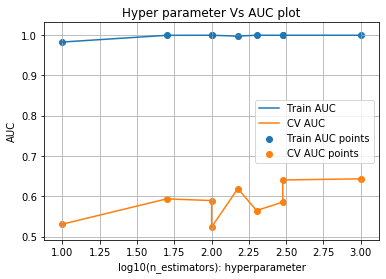

In [104]:
RF_ = RandomForestClassifier(class_weight = "balanced")
parameters = {'n_estimators':[10, 50, 100, 150, 200, 300, 500, 1000],'max_depth':[2,3,4,5,6,7,8,9,10]}
clf = RandomizedSearchCV(RF_, parameters,n_iter = 9, scoring='roc_auc', return_train_score = True)
clf.fit(X_train_set_1, y_train)

results = pd.DataFrame.from_dict(clf.cv_results_)
results = results.sort_values(['param_n_estimators'])


train_auc= results['mean_train_score']
train_auc_std= results['std_train_score']
cv_auc = results['mean_test_score'] 
cv_auc_std= results['std_test_score']
C_ =  results['param_n_estimators'].apply(lambda x: math.log10(x))

plt.plot(C_, train_auc, label='Train AUC')

plt.plot(C_, cv_auc, label='CV AUC')

plt.scatter(C_, train_auc, label='Train AUC points')
plt.scatter(C_, cv_auc, label='CV AUC points')


plt.legend()
plt.xlabel("log10(n_estimators): hyperparameter")
plt.ylabel("AUC")
plt.title("Hyper parameter Vs AUC plot")
plt.grid()
plt.show()


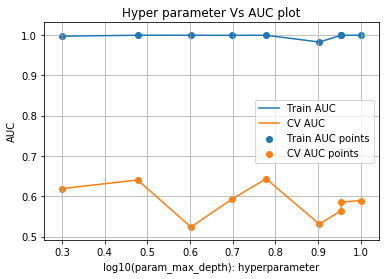

In [105]:
results = results.sort_values(['param_max_depth'])


train_auc= results['mean_train_score']
train_auc_std= results['std_train_score']
cv_auc = results['mean_test_score'] 
cv_auc_std= results['std_test_score']
C_ =  results['param_max_depth'].apply(lambda x: math.log10(x))

plt.plot(C_, train_auc, label='Train AUC')

plt.plot(C_, cv_auc, label='CV AUC')

plt.scatter(C_, train_auc, label='Train AUC points')
plt.scatter(C_, cv_auc, label='CV AUC points')


plt.legend()
plt.xlabel("log10(param_max_depth): hyperparameter")
plt.ylabel("AUC")
plt.title("Hyper parameter Vs AUC plot")
plt.grid()
plt.show()

In [106]:
results

,mean_fit_time,std_fit_time,mean_score_time,std_score_time,param_n_estimators,param_max_depth,params,split0_test_score,split1_test_score,split2_test_score,...,mean_test_score,std_test_score,rank_test_score,split0_train_score,split1_train_score,split2_train_score,split3_train_score,split4_train_score,mean_train_score,std_train_score
3,0.247100,0.008275,0.020599,0.002960,150,2,"{'n_estimators': 150, 'max_depth': 2}",0.377451,0.774510,0.805195,...,0.619137,0.157641,3,0.999722,0.996380,0.997417,0.997130,0.998278,0.997785,0.001143
4,0.548963,0.056624,0.036501,0.000896,300,3,"{'n_estimators': 300, 'max_depth': 3}",0.411765,0.764706,0.735931,...,0.640489,0.148746,2,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,0.000000
7,0.214821,0.020349,0.013902,0.000196,100,4,"{'n_estimators': 100, 'max_depth': 4}",0.348039,0.563725,0.610390,...,0.523478,0.098993,9,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,0.000000
8,0.094000,0.006139,0.007700,0.000402,50,5,"{'n_estimators': 50, 'max_depth': 5}",0.519608,0.647059,0.653680,...,0.593506,0.075490,4,1.000000,0.999722,1.000000,1.000000,0.999426,0.999829,0.000229
5,2.074884,0.107347,0.122921,0.008777,1000,6,"{'n_estimators': 1000, 'max_depth': 6}",0.455882,0.803922,0.666667,...,0.643303,0.114214,1,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,0.000000
6,0.022691,0.002152,0.002804,0.000236,10,8,"{'n_estimators': 10, 'max_depth': 8}",0.406863,0.666667,0.523810,...,0.530723,0.105330,8,0.996101,0.967697,0.982061,0.994546,0.975316,0.983144,0.010945
0,0.536196,0.059843,0.028605,0.005120,200,9,"{'n_estimators': 200, 'max_depth': 9}",0.450980,0.774510,0.476190,...,0.564579,0.114524,7,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,0.000000
2,0.689265,0.051618,0.043516,0.012311,300,9,"{'n_estimators': 300, 'max_depth': 9}",0.411765,0.705882,0.580087,...,0.585434,0.115100,6,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,0.000000
1,0.228352,0.006613,0.014297,0.001160,100,10,"{'n_estimators': 100, 'max_depth': 10}",0.397059,0.848039,0.480519,...,0.589279,0.164174,5,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,0.000000


In [107]:
# the best value for n_estimators and max_depth from the above table
best_n_estimator = 200
best_max_depth = 9

In [108]:
from sklearn.metrics import roc_curve, auc

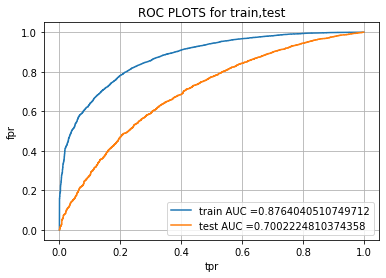

In [109]:
# https://scikit-learn.org/stable/modules/generated/sklearn.metrics.roc_curve.html#sklearn.metrics.roc_curve
from sklearn.metrics import roc_curve, auc


RF_ = RandomForestClassifier(n_estimators = best_n_estimator, max_depth = best_max_depth, class_weight = "balanced")
RF_.fit(X_train_set_1, y_train)
# roc_auc_score(y_true, y_score) the 2nd parameter should be probability estimates of the positive class
# not the predicted outputs

y_train_pred = RF_.predict_proba(X_train_set_1)    
y_test_pred =  RF_.predict_proba(X_test_set_1)   

y_train_pred_prob = []
y_test_pred_prob = []

for index in range(len(y_train_pred)):
    y_train_pred_prob.append(y_train_pred[index][1])

for index in range(len(y_test_pred)):
    y_test_pred_prob.append(y_test_pred[index][1])
    

train_fpr, train_tpr, tr_thresholds = roc_curve(y_train, y_train_pred_prob)
test_fpr, test_tpr, te_thresholds = roc_curve(y_test, y_test_pred_prob)



plt.plot(train_fpr, train_tpr, label="train AUC ="+str(auc(train_fpr, train_tpr)))
plt.plot(test_fpr, test_tpr, label="test AUC ="+str(auc(test_fpr, test_tpr)))

plt.legend()
plt.xlabel("tpr")
plt.ylabel("fpr")
plt.title("ROC PLOTS for train,test")
plt.grid()
plt.show()

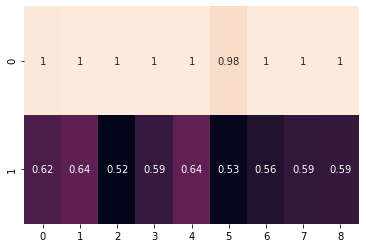

In [110]:
scores = [results['mean_train_score'].values,results['mean_test_score'].values]
sns.heatmap(np.asarray(scores),annot = True, cbar=False)

In [111]:
# we are writing our own function for predict, with defined thresould
# we will pick a threshold that will give the least fpr
def find_best_threshold(threshould, fpr, tpr):
    t = threshould[np.argmax(tpr*(1-fpr))]
    # (tpr*(1-fpr)) will be maximum if your fpr is very low and tpr is very high
    print("the maximum value of tpr*(1-fpr)", max(tpr*(1-fpr)), "for threshold", np.round(t,3))
    return t

def predict_with_best_t(proba, threshould):
    predictions = []
    for i in proba:
        if i>=threshould:
            predictions.append(1)
        else:
            predictions.append(0)
    return predictions

the maximum value of tpr*(1-fpr) 0.6260126476152837 for threshold 0.501
Train confusion matrix


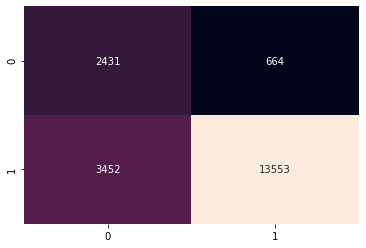

In [112]:
print("="*100)
from sklearn.metrics import confusion_matrix
best_t = find_best_threshold(tr_thresholds, train_fpr, train_tpr)
print("Train confusion matrix")
sns.heatmap(confusion_matrix(y_train, predict_with_best_t(y_train_pred_prob, best_t)),annot = True, fmt = "d", cbar=False)

Test confusion matrix


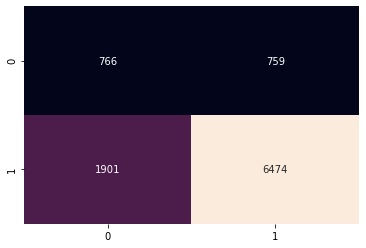

In [113]:
print("Test confusion matrix")
sns.heatmap(confusion_matrix(y_test, predict_with_best_t(y_test_pred_prob, best_t)), annot = True, fmt = "d", cbar=False)

In [114]:
depth = [2,3,4,5,6,7,8,9,10]
estimators = [10,50,100,150,200,300,500]
plot_3d_plot(X_train_set_1, y_train, X_test_set_1, y_test, depth, estimators,"RF_")

### Set 2) categorical(response coding: use probability values), numerical features + project_title(TFIDF)+ preprocessed_eassay (TFIDF)

In [115]:
# merge two sparse matrices: https://stackoverflow.com/a/19710648/4084039
# with the same hstack function we are concatinating a sparse matrix and a dense matirx :)
from scipy.sparse import hstack
X_train_set_2 = hstack((X_train['train_pro_cat_1'].values.reshape(-1,1), X_train['train_pro_cat_0'].values.reshape(-1,1), X_train['train_pro_subcat_1'].values.reshape(-1,1), X_train['train_pro_subcat_0'].values.reshape(-1,1), X_train['train_school_state_1'].values.reshape(-1,1), X_train['train_school_state_0'].values.reshape(-1,1), X_train['train_grade_1'].values.reshape(-1,1),\
                        X_train['train_grade_0'].values.reshape(-1,1),X_train['train_prefix_1'].values.reshape(-1,1),X_train['train_prefix_0'].values.reshape(-1,1),x_train_teacher_number,x_train_price,x_train_quantity,x_train_title_tfidf,x_train_essay_tfidf)).tocsr()
X_test_set_2 = hstack((X_test['test_pro_cat_1'].values.reshape(-1,1),X_test['test_pro_cat_0'].values.reshape(-1,1),X_test['test_pro_subcat_1'].values.reshape(-1,1),X_test['test_pro_subcat_0'].values.reshape(-1,1),X_test['test_school_state_1'].values.reshape(-1,1),X_test['test_school_state_0'].values.reshape(-1,1),X_test['test_grade_1'].values.reshape(-1,1),\
                    X_test['test_grade_0'].values.reshape(-1,1),X_test['test_prefix_1'].values.reshape(-1,1),X_test['test_prefix_0'].values.reshape(-1,1),x_test_teacher_number,x_test_price,x_test_quantity,x_test_title_tfidf,x_test_essay_tfidf)).tocsr()

### Calculating Combine Hyper-Parameters 

In [116]:
RF_ = RandomForestClassifier(class_weight = "balanced")
parameters = {'n_estimators':[10, 50, 100, 150, 200, 300, 500, 1000],'max_depth':[2,3,4,5,6,7,8,9,10]}
clf = RandomizedSearchCV(RF_, parameters,n_iter = 9, scoring='roc_auc', return_train_score = True)
clf.fit(X_train_set_2, y_train)

results = pd.DataFrame.from_dict(clf.cv_results_)

In [117]:
results

,mean_fit_time,std_fit_time,mean_score_time,std_score_time,param_n_estimators,param_max_depth,params,split0_test_score,split1_test_score,split2_test_score,...,mean_test_score,std_test_score,rank_test_score,split0_train_score,split1_train_score,split2_train_score,split3_train_score,split4_train_score,mean_train_score,std_train_score
0,7.640406,0.227881,1.144224,0.112074,500,4,"{'n_estimators': 500, 'max_depth': 4}",0.703437,0.691652,0.686806,...,0.687676,0.012088,3,0.815357,0.810043,0.811708,0.809506,0.818673,0.813057,0.003474
1,1.137128,0.068535,0.136805,0.015658,50,5,"{'n_estimators': 50, 'max_depth': 5}",0.665044,0.644110,0.648804,...,0.646494,0.011106,9,0.774902,0.784769,0.783920,0.783830,0.790077,0.783500,0.004880
2,4.007514,0.278102,0.270112,0.012062,100,10,"{'n_estimators': 100, 'max_depth': 10}",0.683890,0.685839,0.686959,...,0.678943,0.009062,5,0.924586,0.924761,0.920130,0.929507,0.926200,0.925037,0.003023
3,2.704006,0.123833,0.683220,0.056569,300,2,"{'n_estimators': 300, 'max_depth': 2}",0.697108,0.673496,0.668417,...,0.674949,0.013168,7,0.762689,0.766165,0.753672,0.759872,0.756670,0.759813,0.004387
4,3.466756,0.098852,0.241555,0.016177,100,9,"{'n_estimators': 100, 'max_depth': 9}",0.675877,0.693315,0.670744,...,0.675040,0.011608,6,0.912194,0.904256,0.910207,0.905662,0.912826,0.909029,0.003462
5,1.271650,0.053347,0.224548,0.011704,100,3,"{'n_estimators': 100, 'max_depth': 3}",0.677670,0.675792,0.662442,...,0.666526,0.009463,8,0.757294,0.766213,0.754873,0.765777,0.763635,0.761558,0.004618
6,7.544095,0.177640,0.540696,0.026809,200,10,"{'n_estimators': 200, 'max_depth': 10}",0.699664,0.686566,0.685279,...,0.687464,0.007853,4,0.941422,0.939459,0.937838,0.933918,0.934517,0.937431,0.002865
7,10.873345,0.097874,1.123981,0.030397,500,6,"{'n_estimators': 500, 'max_depth': 6}",0.696132,0.693763,0.688896,...,0.688854,0.007129,2,0.870854,0.872892,0.863500,0.862931,0.857927,0.865621,0.005499
8,8.924304,0.096602,0.671370,0.013667,300,8,"{'n_estimators': 300, 'max_depth': 8}",0.709338,0.686579,0.685198,...,0.688938,0.010960,1,0.910424,0.908548,0.901125,0.902843,0.904783,0.905545,0.003471


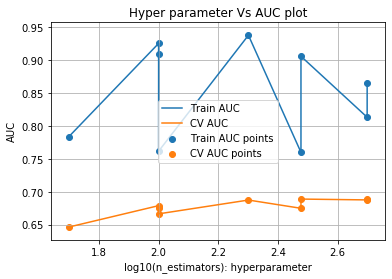

In [118]:
results = results.sort_values(['param_n_estimators'])


train_auc= results['mean_train_score']
train_auc_std= results['std_train_score']
cv_auc = results['mean_test_score'] 
cv_auc_std= results['std_test_score']
C_ =  results['param_n_estimators'].apply(lambda x: math.log10(x))

plt.plot(C_, train_auc, label='Train AUC')

plt.plot(C_, cv_auc, label='CV AUC')

plt.scatter(C_, train_auc, label='Train AUC points')
plt.scatter(C_, cv_auc, label='CV AUC points')


plt.legend()
plt.xlabel("log10(n_estimators): hyperparameter")
plt.ylabel("AUC")
plt.title("Hyper parameter Vs AUC plot")
plt.grid()
plt.show()

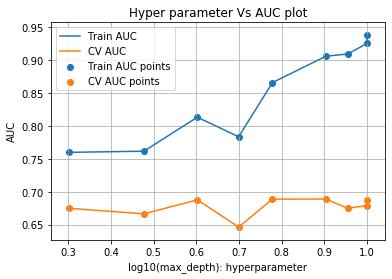

In [119]:
results = results.sort_values(['param_max_depth'])

train_auc= results['mean_train_score']
train_auc_std= results['std_train_score']
cv_auc = results['mean_test_score'] 
cv_auc_std= results['std_test_score']
C_ =  results['param_max_depth'].apply(lambda x: math.log10(x))

plt.plot(C_, train_auc, label='Train AUC')

plt.plot(C_, cv_auc, label='CV AUC')

plt.scatter(C_, train_auc, label='Train AUC points')
plt.scatter(C_, cv_auc, label='CV AUC points')


plt.legend()
plt.xlabel("log10(max_depth): hyperparameter")
plt.ylabel("AUC")
plt.title("Hyper parameter Vs AUC plot")
plt.grid()
plt.show()

In [120]:
# the best value for n_estimators and max_depth from the above table are
best_n_estimator = 300
best_max_depth = 8

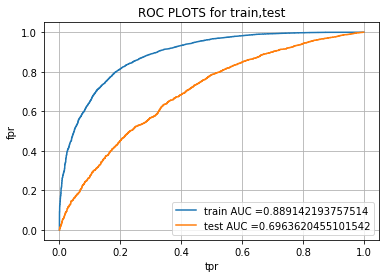

In [121]:
# https://scikit-learn.org/stable/modules/generated/sklearn.metrics.roc_curve.html#sklearn.metrics.roc_curve
RF_ = RandomForestClassifier(n_estimators = best_n_estimator, max_depth = best_max_depth, class_weight = "balanced")
RF_.fit(X_train_set_2, y_train)
# roc_auc_score(y_true, y_score) the 2nd parameter should be probability estimates of the positive class
# not the predicted outputs

y_train_pred = RF_.predict_proba(X_train_set_2)    
y_test_pred =  RF_.predict_proba(X_test_set_2)   

y_train_pred_prob = []
y_test_pred_prob = []

for index in range(len(y_train_pred)):
    y_train_pred_prob.append(y_train_pred[index][1])

for index in range(len(y_test_pred)):
    y_test_pred_prob.append(y_test_pred[index][1])
    

train_fpr, train_tpr, tr_thresholds = roc_curve(y_train, y_train_pred_prob)
test_fpr, test_tpr, te_thresholds = roc_curve(y_test, y_test_pred_prob)



plt.plot(train_fpr, train_tpr, label="train AUC ="+str(auc(train_fpr, train_tpr)))
plt.plot(test_fpr, test_tpr, label="test AUC ="+str(auc(test_fpr, test_tpr)))

plt.legend()
plt.xlabel("tpr")
plt.ylabel("fpr")
plt.title("ROC PLOTS for train,test")
plt.grid()
plt.show()

the maximum value of tpr*(1-fpr) 0.6528308931279833 for threshold 0.506
Train confusion matrix


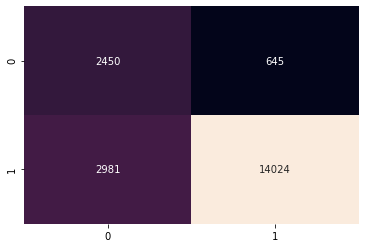

In [122]:
print("="*100)
from sklearn.metrics import confusion_matrix
best_t = find_best_threshold(tr_thresholds, train_fpr, train_tpr)
print("Train confusion matrix")
sns.heatmap(confusion_matrix(y_train, predict_with_best_t(y_train_pred_prob, best_t)),annot = True, fmt = "d", cbar=False)

Test confusion matrix


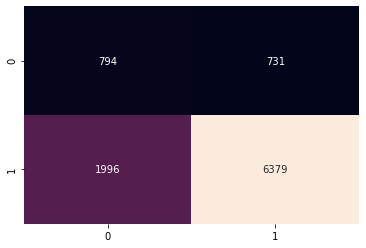

In [123]:
print("Test confusion matrix")
sns.heatmap(confusion_matrix(y_test, predict_with_best_t(y_test_pred_prob, best_t)), annot = True, fmt = "d", cbar=False)

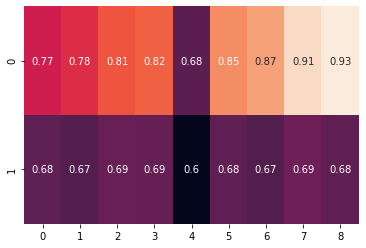

In [194]:
scores  = [results['mean_train_score'].values, results['mean_test_score'].values]
sns.heatmap(np.asarray(scores), annot=True, cbar= False)

In [98]:
depth = [2,3,4,5,6,7,8,9,10]
estimators = [10,50,100,150,200,300,500]
plot_3d_plot(X_train_set_2, y_train, X_test_set_2, y_test, depth, estimators,"RF_")

### Set 3) categorical(response coding: use probability values), numerical features + project_title(AVG W2V)+ preprocessed_eassay (AVG W2V) 

In [195]:
# merge two sparse matrices: https://stackoverflow.com/a/19710648/4084039
# with the same hstack function we are concatinating a sparse matrix and a dense matirx :)
from scipy.sparse import csr_matrix
X_train_set_3 = hstack((csr_matrix(X_train['train_pro_cat_1'].values).reshape(-1,1), csr_matrix(X_train['train_pro_cat_0'].values).reshape(-1,1),csr_matrix(X_train['train_pro_subcat_1'].values).reshape(-1,1), csr_matrix(X_train['train_pro_subcat_0'].values).reshape(-1,1),csr_matrix(X_train['train_school_state_1'].values).reshape(-1,1),csr_matrix(X_train['train_school_state_0'].values).reshape(-1,1),\
                        csr_matrix( X_train['train_grade_1'].values).reshape(-1,1),csr_matrix( X_train['train_grade_0'].values).reshape(-1,1),csr_matrix(X_train['train_prefix_1'].values).reshape(-1,1),csr_matrix(X_train['train_prefix_0'].values).reshape(-1,1),x_train_teacher_number,x_train_price,x_train_quantity,x_train_avg_w2v_title, x_train_avg_w2v_essay)).tocsr()
X_test_set_3 = hstack((csr_matrix(X_test['test_pro_cat_1'].values).reshape(-1,1),csr_matrix(X_test['test_pro_cat_0'].values).reshape(-1,1),csr_matrix(X_test['test_pro_subcat_1'].values).reshape(-1,1),csr_matrix(X_test['test_pro_subcat_0'].values).reshape(-1,1),csr_matrix(X_test['test_school_state_1'].values).reshape(-1,1),csr_matrix(X_test['test_school_state_0'].values).reshape(-1,1),csr_matrix(X_test['test_grade_1'].values).reshape(-1,1),\
                    csr_matrix(X_test['test_grade_0'].values).reshape(-1,1),csr_matrix(X_test['test_prefix_1'].values).reshape(-1,1),csr_matrix(X_test['test_prefix_0'].values).reshape(-1,1),x_test_teacher_number,x_test_price,x_test_quantity, x_test_avg_w2v_title,x_test_avg_w2v_essay)).tocsr()

### Calculating Combine Hyper-Parameters

In [197]:
RF_ = RandomForestClassifier(class_weight = "balanced")
parameters = {'n_estimators':[10, 50, 100, 150, 200, 300, 500, 1000],'max_depth':[2,3,4,5,6,7,8,9,10]}
clf = RandomizedSearchCV(RF_, parameters,n_iter = 9, scoring='roc_auc', return_train_score = True)
clf.fit(X_train_set_3, y_train)

results = pd.DataFrame.from_dict(clf.cv_results_)
results = results.sort_values(['param_n_estimators'])

In [198]:
results

,mean_fit_time,std_fit_time,mean_score_time,std_score_time,param_n_estimators,param_max_depth,params,split0_test_score,split1_test_score,split2_test_score,...,mean_test_score,std_test_score,rank_test_score,split0_train_score,split1_train_score,split2_train_score,split3_train_score,split4_train_score,mean_train_score,std_train_score
3,0.396966,0.005997,0.021812,0.013566,10,7,"{'n_estimators': 10, 'max_depth': 7}",0.598508,0.560647,0.578544,...,0.565818,0.020541,9,0.986164,0.989555,0.986368,0.986283,0.984986,0.986671,0.001527
8,2.017022,0.041508,0.056501,0.009760,50,9,"{'n_estimators': 50, 'max_depth': 9}",0.584594,0.666213,0.652400,...,0.617011,0.035306,8,0.999991,0.999997,1.000000,1.000000,1.000000,0.999997,0.000004
4,2.239859,0.178913,0.117862,0.013082,100,4,"{'n_estimators': 100, 'max_depth': 4}",0.614438,0.647560,0.716475,...,0.625454,0.054846,7,0.985379,0.990820,0.989357,0.982462,0.986508,0.986905,0.002952
1,5.408265,0.405228,0.170044,0.049033,150,7,"{'n_estimators': 150, 'max_depth': 7}",0.656282,0.665658,0.660970,...,0.638955,0.028604,4,1.000000,1.000000,1.000000,0.999997,1.000000,0.999999,0.000001
7,3.004580,0.010015,0.176151,0.022817,200,3,"{'n_estimators': 200, 'max_depth': 3}",0.664499,0.660113,0.702057,...,0.632776,0.055000,6,0.954457,0.962381,0.965681,0.951025,0.946893,0.956087,0.006993
2,4.847715,0.271939,0.313647,0.042912,300,3,"{'n_estimators': 300, 'max_depth': 3}",0.661323,0.695100,0.710173,...,0.647421,0.054728,2,0.955276,0.964937,0.969147,0.958064,0.938045,0.957094,0.010713
5,3.368393,0.124852,0.313928,0.053726,300,2,"{'n_estimators': 300, 'max_depth': 2}",0.661172,0.658046,0.695856,...,0.639963,0.042669,3,0.887869,0.909837,0.906433,0.889523,0.874389,0.893610,0.013014
0,10.127935,0.536526,0.522066,0.086801,500,4,"{'n_estimators': 500, 'max_depth': 4}",0.672565,0.682950,0.694646,...,0.648980,0.043584,1,0.993143,0.993542,0.996763,0.991040,0.989917,0.992881,0.002356
6,10.946567,0.305066,0.809621,0.036345,1000,2,"{'n_estimators': 1000, 'max_depth': 2}",0.659357,0.656433,0.701805,...,0.633664,0.053017,5,0.896562,0.917651,0.916383,0.895366,0.878028,0.900798,0.014784


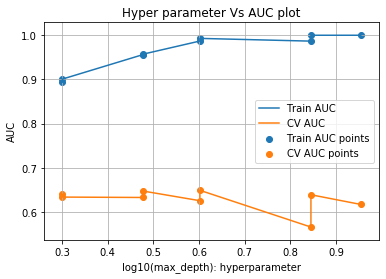

In [199]:
results = results.sort_values(['param_max_depth'])

train_auc= results['mean_train_score']
train_auc_std= results['std_train_score']
cv_auc = results['mean_test_score'] 
cv_auc_std= results['std_test_score']
C_ =  results['param_max_depth'].apply(lambda x: math.log10(x))

plt.plot(C_, train_auc, label='Train AUC')

plt.plot(C_, cv_auc, label='CV AUC')

plt.scatter(C_, train_auc, label='Train AUC points')
plt.scatter(C_, cv_auc, label='CV AUC points')


plt.legend()
plt.xlabel("log10(max_depth): hyperparameter")
plt.ylabel("AUC")
plt.title("Hyper parameter Vs AUC plot")
plt.grid()
plt.show()

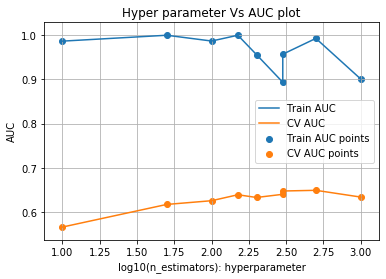

In [200]:
results = results.sort_values(['param_n_estimators'])

train_auc= results['mean_train_score']
train_auc_std= results['std_train_score']
cv_auc = results['mean_test_score'] 
cv_auc_std= results['std_test_score']
C_ =  results['param_n_estimators'].apply(lambda x: math.log10(x))

plt.plot(C_, train_auc, label='Train AUC')

plt.plot(C_, cv_auc, label='CV AUC')

plt.scatter(C_, train_auc, label='Train AUC points')
plt.scatter(C_, cv_auc, label='CV AUC points')


plt.legend()
plt.xlabel("log10(n_estimators): hyperparameter")
plt.ylabel("AUC")
plt.title("Hyper parameter Vs AUC plot")
plt.grid()
plt.show()

In [201]:
# the best value for n_estimators and max_depth from the above graphs are
best_n_estimator = 500
best_max_depth = 4

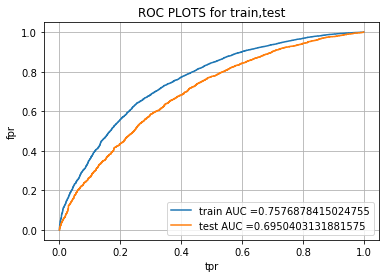

In [202]:
# https://scikit-learn.org/stable/modules/generated/sklearn.metrics.roc_curve.html#sklearn.metrics.roc_curve
RF_ = RandomForestClassifier(n_estimators = best_n_estimator, max_depth = best_max_depth, class_weight = "balanced")
RF_.fit(X_train_set_3, y_train)
# roc_auc_score(y_true, y_score) the 2nd parameter should be probability estimates of the positive class
# not the predicted outputs

y_train_pred = RF_.predict_proba(X_train_set_3)    
y_test_pred =  RF_.predict_proba(X_test_set_3)   

y_train_pred_prob = []
y_test_pred_prob = []

for index in range(len(y_train_pred)):
    y_train_pred_prob.append(y_train_pred[index][1])

for index in range(len(y_test_pred)):
    y_test_pred_prob.append(y_test_pred[index][1])
    

train_fpr, train_tpr, tr_thresholds = roc_curve(y_train, y_train_pred_prob)
test_fpr, test_tpr, te_thresholds = roc_curve(y_test, y_test_pred_prob)



plt.plot(train_fpr, train_tpr, label="train AUC ="+str(auc(train_fpr, train_tpr)))
plt.plot(test_fpr, test_tpr, label="test AUC ="+str(auc(test_fpr, test_tpr)))

plt.legend()
plt.xlabel("tpr")
plt.ylabel("fpr")
plt.title("ROC PLOTS for train,test")
plt.grid()
plt.show()

the maximum value of tpr*(1-fpr) 0.48056687689024274 for threshold 0.508
Train confusion matrix


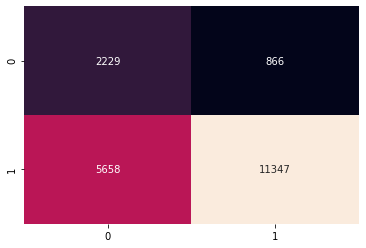

In [203]:
print("="*100)
from sklearn.metrics import confusion_matrix
best_t = find_best_threshold(tr_thresholds, train_fpr, train_tpr)
print("Train confusion matrix")
sns.heatmap(confusion_matrix(y_train, predict_with_best_t(y_train_pred_prob, best_t)),annot = True, fmt = "d", cbar=False)

Test confusion matrix


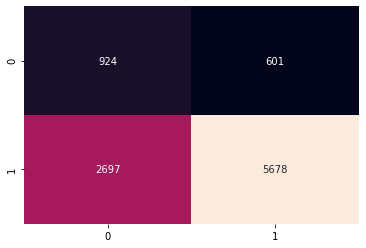

In [204]:
print("Test confusion matrix")
sns.heatmap(confusion_matrix(y_test, predict_with_best_t(y_test_pred_prob, best_t)), annot = True, fmt = "d", cbar=False)

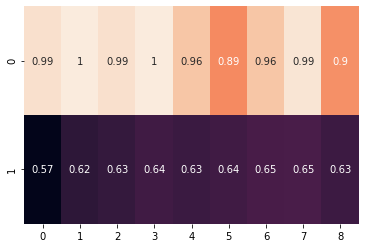

In [205]:
scores = [results['mean_train_score'].values, results['mean_test_score'].values]
sns.heatmap(np.asarray(scores), annot = True, cbar=False)

In [108]:
depth = [2,3,4,5,6,7,8,9,10]
estimators = [10,50,100,150,200,300,500]
plot_3d_plot(X_train_set_3, y_train, X_test_set_3, y_test, depth, estimators, "RF_")

### Set 4) categorical(response coding: use probability values), numerical features + project_title(TFIDF W2V)+ preprocessed_eassay (TFIDF W2V) 

In [206]:
# merge two sparse matrices: https://stackoverflow.com/a/19710648/4084039
# with the same hstack function we are concatinating a sparse matrix and a dense matirx :)
X_train_set_4 = hstack((csr_matrix(X_train['train_pro_cat_1'].values).reshape(-1,1), csr_matrix(X_train['train_pro_cat_0'].values).reshape(-1,1),csr_matrix(X_train['train_pro_subcat_1'].values).reshape(-1,1), csr_matrix(X_train['train_pro_subcat_0'].values).reshape(-1,1),csr_matrix(X_train['train_school_state_1'].values).reshape(-1,1),csr_matrix(X_train['train_school_state_0'].values).reshape(-1,1),\
                        csr_matrix( X_train['train_grade_1'].values).reshape(-1,1),csr_matrix( X_train['train_grade_0'].values).reshape(-1,1),csr_matrix(X_train['train_prefix_1'].values).reshape(-1,1),csr_matrix(X_train['train_prefix_0'].values).reshape(-1,1),x_train_teacher_number,x_train_price,x_train_quantity,x_train_weighted_w2v_title, x_train_weighted_w2v_essay)).tocsr()
X_test_set_4 = hstack((csr_matrix(X_test['test_pro_cat_1'].values).reshape(-1,1),csr_matrix(X_test['test_pro_cat_0'].values).reshape(-1,1),csr_matrix(X_test['test_pro_subcat_1'].values).reshape(-1,1),csr_matrix(X_test['test_pro_subcat_0'].values).reshape(-1,1),csr_matrix(X_test['test_school_state_1'].values).reshape(-1,1),csr_matrix(X_test['test_school_state_0'].values).reshape(-1,1),csr_matrix(X_test['test_grade_1'].values).reshape(-1,1),\
                    csr_matrix(X_test['test_grade_0'].values).reshape(-1,1),csr_matrix(X_test['test_prefix_1'].values).reshape(-1,1),csr_matrix(X_test['test_prefix_0'].values).reshape(-1,1),x_test_teacher_number,x_test_price,x_test_quantity, x_test_weighted_w2v_title,x_test_weighted_w2v_essay)).tocsr()

### Calculating Combine Hyper-Parameters

In [211]:
RF_ = RandomForestClassifier(class_weight = "balanced")
parameters = {'n_estimators':[10, 50, 100, 150, 200, 300, 500, 1000],'max_depth':[2,3,4,5,6,7,8,9,10]}
clf = RandomizedSearchCV(RF_, parameters,n_iter = 9, scoring='roc_auc', return_train_score = True)
clf.fit(X_train_set_4, y_train)

results = pd.DataFrame.from_dict(clf.cv_results_)
results = results.sort_values(['param_n_estimators'])


In [212]:
results

,mean_fit_time,std_fit_time,mean_score_time,std_score_time,param_n_estimators,param_max_depth,params,split0_test_score,split1_test_score,split2_test_score,...,mean_test_score,std_test_score,rank_test_score,split0_train_score,split1_train_score,split2_train_score,split3_train_score,split4_train_score,mean_train_score,std_train_score
3,0.371997,0.008068,0.011294,0.000687,10,8,"{'n_estimators': 10, 'max_depth': 8}",0.653670,0.558882,0.649435,...,0.594094,0.053718,9,0.987143,0.989036,0.987369,0.990070,0.987973,0.988318,0.001094
1,1.079607,0.037545,0.031998,0.002531,50,5,"{'n_estimators': 50, 'max_depth': 5}",0.648332,0.644957,0.613415,...,0.624312,0.033010,7,0.984489,0.989206,0.983550,0.990072,0.985608,0.986585,0.002592
6,0.470455,0.007614,0.034295,0.000977,50,2,"{'n_estimators': 50, 'max_depth': 2}",0.646028,0.668224,0.615362,...,0.639019,0.037625,6,0.829056,0.842103,0.817654,0.816639,0.837027,0.828496,0.010162
8,1.278673,0.067645,0.037629,0.003479,50,6,"{'n_estimators': 50, 'max_depth': 6}",0.637494,0.625195,0.599039,...,0.621495,0.036232,8,0.993384,0.998505,0.995445,0.997035,0.996733,0.996220,0.001720
7,3.509688,0.026575,0.064440,0.001643,100,9,"{'n_estimators': 100, 'max_depth': 9}",0.680328,0.657191,0.622242,...,0.643821,0.031021,5,1.000000,1.000000,1.000000,1.000000,0.999996,0.999999,0.000002
0,5.057817,0.343219,0.106022,0.018510,150,8,"{'n_estimators': 150, 'max_depth': 8}",0.678187,0.657580,0.623670,...,0.649624,0.034448,2,0.999996,1.000000,1.000000,1.000000,1.000000,0.999999,0.000002
5,4.367771,0.087024,0.107195,0.021847,150,7,"{'n_estimators': 150, 'max_depth': 7}",0.665206,0.653784,0.635871,...,0.649838,0.037297,1,0.999921,0.999992,0.999966,0.999992,0.999939,0.999962,0.000028
2,2.898401,0.142856,0.177992,0.017325,300,2,"{'n_estimators': 300, 'max_depth': 2}",0.650636,0.676142,0.618737,...,0.645282,0.037836,4,0.838371,0.867546,0.857016,0.853759,0.855165,0.854372,0.009355
4,5.676710,0.443878,0.230635,0.034477,300,4,"{'n_estimators': 300, 'max_depth': 4}",0.656931,0.675883,0.632496,...,0.647806,0.040806,3,0.966353,0.978704,0.977051,0.968985,0.973968,0.973012,0.004695


In [213]:
# the best value for n_estimators and max_depth from the above table are
best_n_estimator = 10
best_max_depth = 9

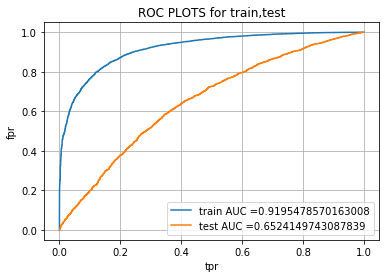

In [214]:
# https://scikit-learn.org/stable/modules/generated/sklearn.metrics.roc_curve.html#sklearn.metrics.roc_curve
RF_ = RandomForestClassifier(n_estimators = best_n_estimator, max_depth = best_max_depth, class_weight = "balanced")
RF_.fit(X_train_set_4, y_train)
# roc_auc_score(y_true, y_score) the 2nd parameter should be probability estimates of the positive class
# not the predicted outputs

y_train_pred = RF_.predict_proba(X_train_set_4)    
y_test_pred =  RF_.predict_proba(X_test_set_4)   

y_train_pred_prob = []
y_test_pred_prob = []

for index in range(len(y_train_pred)):
    y_train_pred_prob.append(y_train_pred[index][1])

for index in range(len(y_test_pred)):
    y_test_pred_prob.append(y_test_pred[index][1])
    

train_fpr, train_tpr, tr_thresholds = roc_curve(y_train, y_train_pred_prob)
test_fpr, test_tpr, te_thresholds = roc_curve(y_test, y_test_pred_prob)



plt.plot(train_fpr, train_tpr, label="train AUC ="+str(auc(train_fpr, train_tpr)))
plt.plot(test_fpr, test_tpr, label="test AUC ="+str(auc(test_fpr, test_tpr)))

plt.legend()
plt.xlabel("tpr")
plt.ylabel("fpr")
plt.title("ROC PLOTS for train,test")
plt.grid()
plt.show()

the maximum value of tpr*(1-fpr) 0.7069230517110097 for threshold 0.521
Train confusion matrix


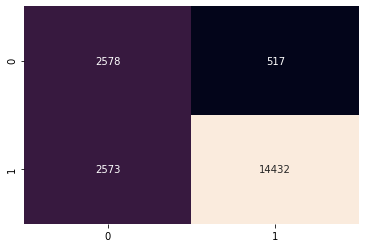

In [215]:
print("="*100)
from sklearn.metrics import confusion_matrix
best_t = find_best_threshold(tr_thresholds, train_fpr, train_tpr)
print("Train confusion matrix")
sns.heatmap(confusion_matrix(y_train, predict_with_best_t(y_train_pred_prob, best_t)),annot = True, fmt = "d", cbar=False)

Test confusion matrix


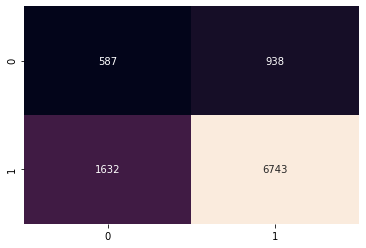

In [216]:
print("Test confusion matrix")
sns.heatmap(confusion_matrix(y_test, predict_with_best_t(y_test_pred_prob, best_t)), annot = True, fmt = "d", cbar=False)

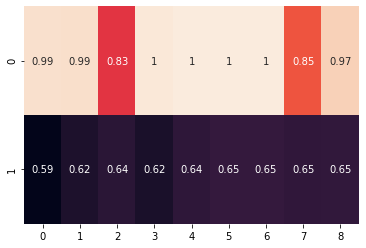

In [218]:
scores = [results['mean_train_score'].values, results['mean_test_score'].values]
sns.heatmap(np.asarray(scores),annot = True,cbar=False)

In [117]:
depth = [2,3,4,5,6,7,8,9,10]
estimators = [10,50,100,150,200,300,500]
plot_3d_plot(X_train_set_4, y_train, X_test_set_4, y_test, depth, estimators, "RF_")

## 3.2) Gradient Boosted Decision Trees

### Set 1) categorical(response coding: use probability values), numerical features + project_title(BOW) + preprocessed_eassay (BOW)

In [219]:
from sklearn.ensemble import GradientBoostingClassifier

### Calculating Combine Hyper-Parameters

In [232]:
GB_ = GradientBoostingClassifier()
parameters = {'n_estimators':[10, 50, 100, 150, 200, 300, 500, 1000], 'max_depth':[2,3,4,5,6,7,8,9,10]}
clf = RandomizedSearchCV(GB_, parameters,n_iter = 8, scoring='roc_auc', return_train_score=True)
clf.fit(X_train_set_1, y_train)

results = pd.DataFrame.from_dict(clf.cv_results_)
results = results.sort_values(['param_n_estimators'])

In [233]:
results

,mean_fit_time,std_fit_time,mean_score_time,std_score_time,param_n_estimators,param_max_depth,params,split0_test_score,split1_test_score,split2_test_score,...,mean_test_score,std_test_score,rank_test_score,split0_train_score,split1_train_score,split2_train_score,split3_train_score,split4_train_score,mean_train_score,std_train_score
3,0.803711,0.079007,0.003598,0.000373,10,9,"{'n_estimators': 10, 'max_depth': 9}",0.505098,0.426667,0.586275,...,0.512078,0.051310,5,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,7.021667e-17
5,0.528480,0.048005,0.004008,0.000318,10,5,"{'n_estimators': 10, 'max_depth': 5}",0.490588,0.392941,0.576078,...,0.491451,0.074319,8,0.964975,0.999926,0.964167,0.989951,0.965025,0.976809,1.513845e-02
6,2.080649,0.133949,0.004305,0.000808,50,4,"{'n_estimators': 50, 'max_depth': 4}",0.608235,0.416471,0.580392,...,0.532706,0.067075,2,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,0.000000e+00
0,6.533692,0.391517,0.004007,0.000450,100,7,"{'n_estimators': 100, 'max_depth': 7}",0.605490,0.463137,0.603137,...,0.543922,0.054659,1,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,0.000000e+00
1,7.742294,0.273951,0.004285,0.000583,300,2,"{'n_estimators': 300, 'max_depth': 2}",0.489412,0.423137,0.629412,...,0.523137,0.069925,3,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,0.000000e+00
4,17.355465,0.679673,0.007097,0.002400,300,7,"{'n_estimators': 300, 'max_depth': 7}",0.553333,0.482353,0.542745,...,0.519529,0.025561,4,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,0.000000e+00
7,22.236497,0.838947,0.006911,0.001243,300,9,"{'n_estimators': 300, 'max_depth': 9}",0.538039,0.492549,0.586667,...,0.506980,0.062991,6,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,0.000000e+00
2,26.305203,1.319721,0.008696,0.002461,500,7,"{'n_estimators': 500, 'max_depth': 7}",0.527451,0.471373,0.556078,...,0.492549,0.045797,7,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,0.000000e+00


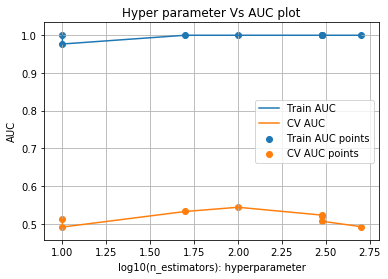

In [236]:
train_auc= results['mean_train_score']
train_auc_std= results['std_train_score']
cv_auc = results['mean_test_score'] 
cv_auc_std= results['std_test_score']
C_ =  results['param_n_estimators'].apply(lambda x: math.log10(x))

plt.plot(C_, train_auc, label='Train AUC')

plt.plot(C_, cv_auc, label='CV AUC')

plt.scatter(C_, train_auc, label='Train AUC points')
plt.scatter(C_, cv_auc, label='CV AUC points')


plt.legend()
plt.xlabel("log10(n_estimators): hyperparameter")
plt.ylabel("AUC")
plt.title("Hyper parameter Vs AUC plot")
plt.grid()
plt.show()

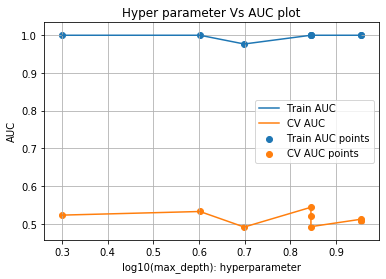

In [237]:
results = results.sort_values(['param_max_depth'])

train_auc= results['mean_train_score']
train_auc_std= results['std_train_score']
cv_auc = results['mean_test_score'] 
cv_auc_std= results['std_test_score']
C_ =  results['param_max_depth'].apply(lambda x: math.log10(x))

plt.plot(C_, train_auc, label='Train AUC')

plt.plot(C_, cv_auc, label='CV AUC')

plt.scatter(C_, train_auc, label='Train AUC points')
plt.scatter(C_, cv_auc, label='CV AUC points')


plt.legend()
plt.xlabel("log10(max_depth): hyperparameter")
plt.ylabel("AUC")
plt.title("Hyper parameter Vs AUC plot")
plt.grid()
plt.show()

In [234]:
# the best value for n_estimators and max_depth from the above graphs are
best_n_estimator = 50
best_max_depth = 4

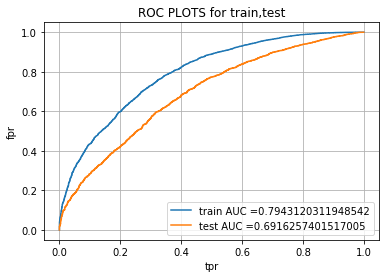

In [235]:
# https://scikit-learn.org/stable/modules/generated/sklearn.metrics.roc_curve.html#sklearn.metrics.roc_curve
GB_ = GradientBoostingClassifier(n_estimators = best_n_estimator, max_depth = best_max_depth)
GB_.fit(X_train_set_1, y_train)
# roc_auc_score(y_true, y_score) the 2nd parameter should be probability estimates of the positive class
# not the predicted outputs

y_train_pred = GB_.predict_proba(X_train_set_1)    
y_test_pred =  GB_.predict_proba(X_test_set_1)   

y_train_pred_prob = []
y_test_pred_prob = []

for index in range(len(y_train_pred)):
    y_train_pred_prob.append(y_train_pred[index][1])

for index in range(len(y_test_pred)):
    y_test_pred_prob.append(y_test_pred[index][1])
    

train_fpr, train_tpr, tr_thresholds = roc_curve(y_train, y_train_pred_prob)
test_fpr, test_tpr, te_thresholds = roc_curve(y_test, y_test_pred_prob)



plt.plot(train_fpr, train_tpr, label="train AUC ="+str(auc(train_fpr, train_tpr)))
plt.plot(test_fpr, test_tpr, label="test AUC ="+str(auc(test_fpr, test_tpr)))

plt.legend()
plt.xlabel("tpr")
plt.ylabel("fpr")
plt.title("ROC PLOTS for train,test")
plt.grid()
plt.show()

the maximum value of tpr*(1-fpr) 0.5135875554989766 for threshold 0.829
Train confusion matrix


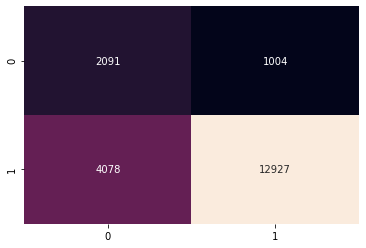

In [238]:
print("="*100)
from sklearn.metrics import confusion_matrix
best_t = find_best_threshold(tr_thresholds, train_fpr, train_tpr)
print("Train confusion matrix")
sns.heatmap(confusion_matrix(y_train, predict_with_best_t(y_train_pred_prob, best_t)),annot = True, fmt = "d", cbar=False)

Test confusion matrix


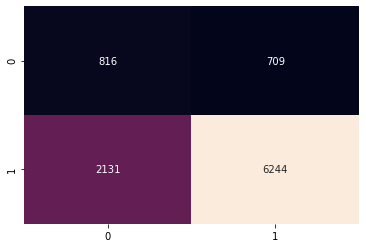

In [239]:
print("Test confusion matrix")
sns.heatmap(confusion_matrix(y_test, predict_with_best_t(y_test_pred_prob, best_t)), annot = True, fmt = "d", cbar=False)

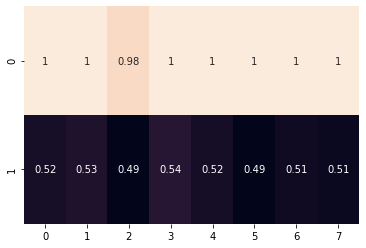

In [240]:
scores = [results['mean_train_score'].values, results['mean_test_score'].values]
sns.heatmap(np.asarray(scores),annot = True, cbar=False)

In [241]:
depth = [2,3,4,5,6,7,8,9,10]
estimators = [10,50,100,150,200,300,500]
plot_3d_plot(X_train_set_1, y_train, X_test_set_1, y_test, depth, estimators, algo = "GB_")

### Set 2) categorical(response coding: use probability values), numerical features + project_title(TFIDF)+ preprocessed_eassay (TFIDF)

In [242]:
from sklearn.ensemble import GradientBoostingClassifier
from sklearn.model_selection import GridSearchCV
from scipy.stats import randint as sp_randint
from sklearn.model_selection import RandomizedSearchCV
import matplotlib.pyplot as plt
from sklearn.metrics import roc_auc_score
from sklearn.ensemble import RandomForestClassifier
import math

### Calculating Combine Hyper-Parameters

In [279]:
GB_ = GradientBoostingClassifier()
parameters = {'n_estimators':[10, 50, 100, 150, 200, 300, 500, 1000],'max_depth':[2,3,4,5,6,7,8,9,10]}
clf = RandomizedSearchCV(GB_, parameters,n_iter = 9, scoring='roc_auc', return_train_score = True)
clf.fit(X_train_set_2, y_train)

results = pd.DataFrame.from_dict(clf.cv_results_)
results = results.sort_values(['param_max_depth'])
results

,mean_fit_time,std_fit_time,mean_score_time,std_score_time,param_n_estimators,param_max_depth,params,split0_test_score,split1_test_score,split2_test_score,...,mean_test_score,std_test_score,rank_test_score,split0_train_score,split1_train_score,split2_train_score,split3_train_score,split4_train_score,mean_train_score,std_train_score
2,12.869973,0.069965,0.004296,0.000398,150,4,"{'n_estimators': 150, 'max_depth': 4}",0.582537,0.617867,0.590240,...,0.583618,0.020093,4,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,0.000000
1,1.093199,0.053436,0.003795,0.001113,10,5,"{'n_estimators': 10, 'max_depth': 5}",0.568418,0.559589,0.536197,...,0.559298,0.017089,9,0.972903,0.935195,0.956966,0.978134,0.953037,0.959247,0.015267
6,8.060015,0.314129,0.002496,0.000441,100,5,"{'n_estimators': 100, 'max_depth': 5}",0.605586,0.683908,0.552934,...,0.582218,0.057293,5,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,0.000000
8,26.884331,1.973777,0.004499,0.000444,300,6,"{'n_estimators': 300, 'max_depth': 6}",0.618148,0.595281,0.615648,...,0.600419,0.014148,1,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,0.000000
3,24.769889,0.596861,0.005410,0.000382,150,8,"{'n_estimators': 150, 'max_depth': 8}",0.590324,0.585199,0.570478,...,0.593140,0.015868,3,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,0.000000
0,9.732167,0.502142,0.004898,0.001117,50,9,"{'n_estimators': 50, 'max_depth': 9}",0.615137,0.596592,0.609901,...,0.597377,0.033999,2,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,0.000000
5,53.651707,5.584866,0.008706,0.001992,300,9,"{'n_estimators': 300, 'max_depth': 9}",0.584510,0.588123,0.611111,...,0.581229,0.019477,6,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,0.000000
7,1.520379,0.065109,0.002502,0.000448,10,9,"{'n_estimators': 10, 'max_depth': 9}",0.598526,0.599214,0.577233,...,0.566186,0.041483,8,0.991039,0.995309,1.000000,1.000000,1.000000,0.997270,0.003606
4,31.370350,0.579829,0.005707,0.000245,150,10,"{'n_estimators': 150, 'max_depth': 10}",0.584510,0.593769,0.581166,...,0.579515,0.009591,7,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,0.000000


In [280]:
# the best value for n_estimators and max_depth from the above graphs are
best_n_estimator = 50
best_max_depth = 9

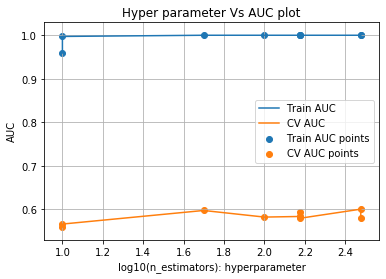

In [281]:
results = results.sort_values(['param_n_estimators'])

train_auc= results['mean_train_score']
train_auc_std= results['std_train_score']
cv_auc = results['mean_test_score'] 
cv_auc_std= results['std_test_score']
C_ =  results['param_n_estimators'].apply(lambda x: math.log10(x))

plt.plot(C_, train_auc, label='Train AUC')

plt.plot(C_, cv_auc, label='CV AUC')

plt.scatter(C_, train_auc, label='Train AUC points')
plt.scatter(C_, cv_auc, label='CV AUC points')


plt.legend()
plt.xlabel("log10(n_estimators): hyperparameter")
plt.ylabel("AUC")
plt.title("Hyper parameter Vs AUC plot")
plt.grid()
plt.show()

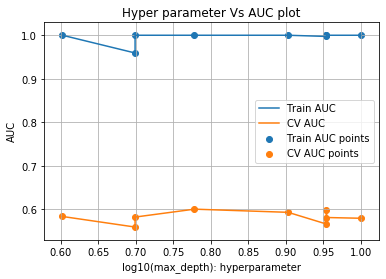

In [282]:
results = results.sort_values(['param_max_depth'])

train_auc= results['mean_train_score']
train_auc_std= results['std_train_score']
cv_auc = results['mean_test_score'] 
cv_auc_std= results['std_test_score']
C_ =  results['param_max_depth'].apply(lambda x: math.log10(x))

plt.plot(C_, train_auc, label='Train AUC')

plt.plot(C_, cv_auc, label='CV AUC')

plt.scatter(C_, train_auc, label='Train AUC points')
plt.scatter(C_, cv_auc, label='CV AUC points')


plt.legend()
plt.xlabel("log10(max_depth): hyperparameter")
plt.ylabel("AUC")
plt.title("Hyper parameter Vs AUC plot")
plt.grid()
plt.show()

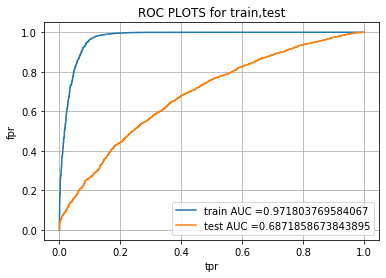

In [283]:
# https://scikit-learn.org/stable/modules/generated/sklearn.metrics.roc_curve.html#sklearn.metrics.roc_curve
GB_ = GradientBoostingClassifier(n_estimators = best_n_estimator, max_depth = best_max_depth)
GB_.fit(X_train_set_2, y_train)
# roc_auc_score(y_true, y_score) the 2nd parameter should be probability estimates of the positive class
# not the predicted outputs

y_train_pred = GB_.predict_proba(X_train_set_2)    
y_test_pred =  GB_.predict_proba(X_test_set_2)   

y_train_pred_prob = []
y_test_pred_prob = []

for index in range(len(y_train_pred)):
    y_train_pred_prob.append(y_train_pred[index][1])

for index in range(len(y_test_pred)):
    y_test_pred_prob.append(y_test_pred[index][1])
    

train_fpr, train_tpr, tr_thresholds = roc_curve(y_train, y_train_pred_prob)
test_fpr, test_tpr, te_thresholds = roc_curve(y_test, y_test_pred_prob)



plt.plot(train_fpr, train_tpr, label="train AUC ="+str(auc(train_fpr, train_tpr)))
plt.plot(test_fpr, test_tpr, label="test AUC ="+str(auc(test_fpr, test_tpr)))

plt.legend()
plt.xlabel("tpr")
plt.ylabel("fpr")
plt.title("ROC PLOTS for train,test")
plt.grid()
plt.show()

the maximum value of tpr*(1-fpr) 0.8681887442589109 for threshold 0.808
Train confusion matrix


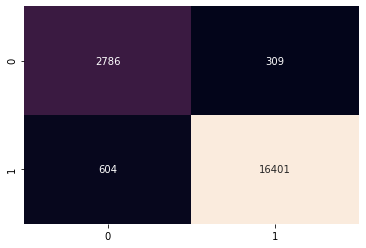

In [284]:
print("="*100)
from sklearn.metrics import confusion_matrix
best_t = find_best_threshold(tr_thresholds, train_fpr, train_tpr)
print("Train confusion matrix")
sns.heatmap(confusion_matrix(y_train, predict_with_best_t(y_train_pred_prob, best_t)),annot = True, fmt = "d", cbar=False)

Test confusion matrix


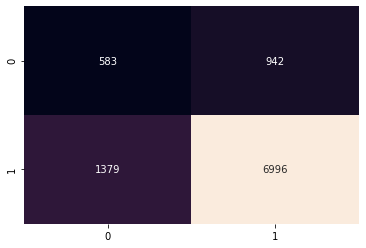

In [285]:
print("Test confusion matrix")
sns.heatmap(confusion_matrix(y_test, predict_with_best_t(y_test_pred_prob, best_t)), annot = True, fmt = "d", cbar=False)

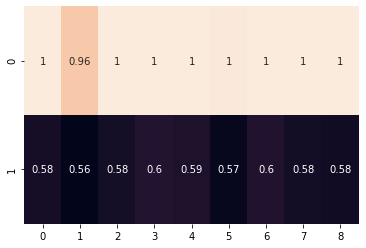

In [287]:
scores = [results['mean_train_score'].values, results['mean_test_score'].values]
sns.heatmap(np.asarray(scores),annot = True, cbar=False)

In [151]:
depth = [2,3,4,5,6,7,8,9,10]
estimators = [10,50,100,150,200,300,500]
plot_3d_plot(X_train_set_2, y_train, X_test_set_2, y_test, depth, estimators, algo = 'GB_')

### Set 3) categorical(response coding: use probability values), numerical features + project_title(AVG W2V)+ preprocessed_eassay (AVG W2V)

### Calculating Combine Hyper-Parameters

In [261]:
GB_ = GradientBoostingClassifier()
parameters = {'n_estimators':[10, 50, 100, 150, 200, 300, 500, 1000], 'max_depth':[2,3,4,5,6,7,8,9,10]}
clf = RandomizedSearchCV(GB_, parameters,n_iter = 8, scoring='roc_auc', return_train_score = True)
clf.fit(X_train_set_3, y_train)

results = pd.DataFrame.from_dict(clf.cv_results_)
results = results.sort_values(['param_n_estimators'])
results

,mean_fit_time,std_fit_time,mean_score_time,std_score_time,param_n_estimators,param_max_depth,params,split0_test_score,split1_test_score,split2_test_score,...,mean_test_score,std_test_score,rank_test_score,split0_train_score,split1_train_score,split2_train_score,split3_train_score,split4_train_score,mean_train_score,std_train_score
2,0.659660,0.024315,0.003902,0.001110,10,2,"{'n_estimators': 10, 'max_depth': 2}",0.589020,0.520000,0.721569,...,0.629176,0.070928,2,0.921299,0.965319,0.901127,0.922794,0.931152,0.928338,0.020958
5,1.251189,0.021426,0.003403,0.000376,10,4,"{'n_estimators': 10, 'max_depth': 4}",0.512941,0.472157,0.745882,...,0.528549,0.113590,8,0.988529,0.989510,0.999093,0.978235,0.999314,0.990936,0.007821
1,20.470414,0.633090,0.006907,0.002611,100,6,"{'n_estimators': 100, 'max_depth': 6}",0.547451,0.446275,0.628235,...,0.534353,0.062091,7,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,0.000000
3,10.095314,0.721341,0.004967,0.001814,150,2,"{'n_estimators': 150, 'max_depth': 2}",0.670588,0.580392,0.740392,...,0.645020,0.055726,1,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,0.000000
4,14.488546,0.815637,0.004400,0.000974,150,3,"{'n_estimators': 150, 'max_depth': 3}",0.701176,0.516863,0.712157,...,0.622902,0.078676,3,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,0.000000
6,36.070863,5.697585,0.005698,0.001070,300,5,"{'n_estimators': 300, 'max_depth': 5}",0.567843,0.507451,0.692549,...,0.583843,0.062811,6,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,0.000000
7,37.875498,0.954277,0.005904,0.000749,300,4,"{'n_estimators': 300, 'max_depth': 4}",0.611765,0.512157,0.771765,...,0.611922,0.086937,4,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,0.000000
0,27.377544,3.319729,0.005572,0.000985,1000,7,"{'n_estimators': 1000, 'max_depth': 7}",0.614118,0.503529,0.654118,...,0.594667,0.052375,5,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,0.000000


In [262]:
# the best value for n_estimators and max_depth from the above graphs are
best_n_estimator = 150
best_max_depth = 3

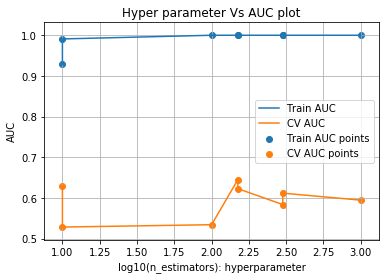

In [263]:
results = results.sort_values(['param_n_estimators'])

train_auc= results['mean_train_score']
train_auc_std= results['std_train_score']
cv_auc = results['mean_test_score'] 
cv_auc_std= results['std_test_score']
C_ =  results['param_n_estimators'].apply(lambda x: math.log10(x))

plt.plot(C_, train_auc, label='Train AUC')

plt.plot(C_, cv_auc, label='CV AUC')

plt.scatter(C_, train_auc, label='Train AUC points')
plt.scatter(C_, cv_auc, label='CV AUC points')


plt.legend()
plt.xlabel("log10(n_estimators): hyperparameter")
plt.ylabel("AUC")
plt.title("Hyper parameter Vs AUC plot")
plt.grid()
plt.show()

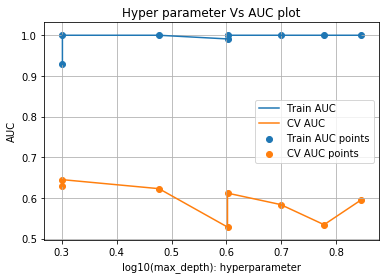

In [264]:
results = results.sort_values(['param_max_depth'])

train_auc= results['mean_train_score']
train_auc_std= results['std_train_score']
cv_auc = results['mean_test_score'] 
cv_auc_std= results['std_test_score']
C_ =  results['param_max_depth'].apply(lambda x: math.log10(x))

plt.plot(C_, train_auc, label='Train AUC')

plt.plot(C_, cv_auc, label='CV AUC')

plt.scatter(C_, train_auc, label='Train AUC points')
plt.scatter(C_, cv_auc, label='CV AUC points')


plt.legend()
plt.xlabel("log10(max_depth): hyperparameter")
plt.ylabel("AUC")
plt.title("Hyper parameter Vs AUC plot")
plt.grid()
plt.show()

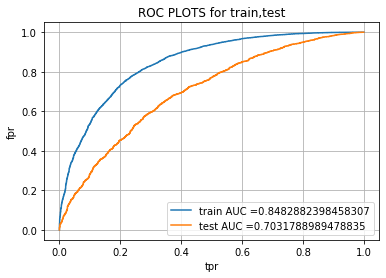

In [265]:
# https://scikit-learn.org/stable/modules/generated/sklearn.metrics.roc_curve.html#sklearn.metrics.roc_curve
GB_ = GradientBoostingClassifier(n_estimators = best_n_estimator, max_depth = best_max_depth)
GB_.fit(X_train_set_3, y_train)
# roc_auc_score(y_true, y_score) the 2nd parameter should be probability estimates of the positive class
# not the predicted outputs

y_train_pred = GB_.predict_proba(X_train_set_3)    
y_test_pred =  GB_.predict_proba(X_test_set_3)   

y_train_pred_prob = []
y_test_pred_prob = []

for index in range(len(y_train_pred)):
    y_train_pred_prob.append(y_train_pred[index][1])

for index in range(len(y_test_pred)):
    y_test_pred_prob.append(y_test_pred[index][1])
    

train_fpr, train_tpr, tr_thresholds = roc_curve(y_train, y_train_pred_prob)
test_fpr, test_tpr, te_thresholds = roc_curve(y_test, y_test_pred_prob)



plt.plot(train_fpr, train_tpr, label="train AUC ="+str(auc(train_fpr, train_tpr)))
plt.plot(test_fpr, test_tpr, label="test AUC ="+str(auc(test_fpr, test_tpr)))

plt.legend()
plt.xlabel("tpr")
plt.ylabel("fpr")
plt.title("ROC PLOTS for train,test")
plt.grid()
plt.show()

the maximum value of tpr*(1-fpr) 0.5937330035497496 for threshold 0.831
Train confusion matrix


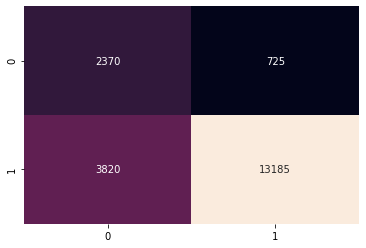

In [266]:
print("="*100)
from sklearn.metrics import confusion_matrix
best_t = find_best_threshold(tr_thresholds, train_fpr, train_tpr)
print("Train confusion matrix")
sns.heatmap(confusion_matrix(y_train, predict_with_best_t(y_train_pred_prob, best_t)),annot = True, fmt = "d", cbar=False)

Test confusion matrix


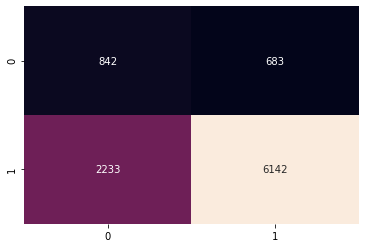

In [267]:
print("Test confusion matrix")
sns.heatmap(confusion_matrix(y_test, predict_with_best_t(y_test_pred_prob, best_t)), annot = True, fmt = "d", cbar=False)

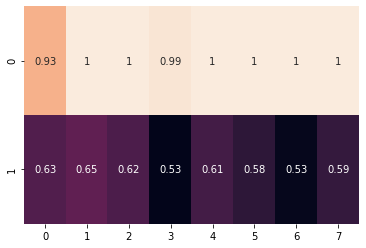

In [269]:
scores = [results['mean_train_score'].values, results['mean_test_score'].values]
sns.heatmap(np.asarray(scores), annot = True, cbar=False)

In [118]:
depth = [2,3,4,5,6,7,8,9,10]
estimators = [10,50,100,150,200,300,500]
plot_3d_plot(X_train_set_3, y_train, X_test_set_3, y_test, depth, estimators, algo = "GB_")

### Set 4) categorical(response coding: use probability values), numerical features + project_title(TFIDF W2V)+ preprocessed_eassay (TFIDF W2V)

### Calculating Combine Hyper-Parameters

In [278]:
GB_ = GradientBoostingClassifier()
parameters = {'n_estimators':[10, 50, 100, 150, 200, 300, 500, 1000], 'max_depth':[2,3,4,5,6,7,8,9,10]}
clf = RandomizedSearchCV(GB_, parameters,n_iter = 8, scoring='roc_auc', return_train_score = True)
clf.fit(X_train_set_4, y_train)

results = pd.DataFrame.from_dict(clf.cv_results_)
results = results.sort_values(['param_n_estimators'])
results

,mean_fit_time,std_fit_time,mean_score_time,std_score_time,param_n_estimators,param_max_depth,params,split0_test_score,split1_test_score,split2_test_score,...,mean_test_score,std_test_score,rank_test_score,split0_train_score,split1_train_score,split2_train_score,split3_train_score,split4_train_score,mean_train_score,std_train_score
0,0.949910,0.016993,0.003100,0.000200,10,3,"{'n_estimators': 10, 'max_depth': 3}",0.622353,0.537255,0.561961,...,0.594275,0.050380,7,0.981005,0.983137,0.971005,0.948946,0.979681,0.972755,0.012600
3,1.244781,0.026956,0.003100,0.000188,10,4,"{'n_estimators': 10, 'max_depth': 4}",0.505098,0.570588,0.481961,...,0.560863,0.058717,8,0.983652,0.997108,0.991299,0.978750,0.989240,0.988010,0.006322
4,12.358133,0.226298,0.004489,0.000711,50,8,"{'n_estimators': 50, 'max_depth': 8}",0.664314,0.629020,0.647451,...,0.653020,0.019053,2,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,0.000000
1,6.395110,0.078714,0.003395,0.000379,100,2,"{'n_estimators': 100, 'max_depth': 2}",0.530196,0.600784,0.716078,...,0.624000,0.064479,6,1.000000,1.000000,1.000000,0.999510,1.000000,0.999902,0.000196
2,23.609481,0.533504,0.004304,0.000238,150,5,"{'n_estimators': 150, 'max_depth': 5}",0.563137,0.636863,0.623529,...,0.638118,0.053785,3,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,0.000000
5,25.645134,1.874733,0.004691,0.000235,150,7,"{'n_estimators': 150, 'max_depth': 7}",0.596863,0.686275,0.711373,...,0.659922,0.038858,1,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,0.000000
7,14.532658,0.386343,0.004300,0.000677,150,3,"{'n_estimators': 150, 'max_depth': 3}",0.552941,0.592157,0.677647,...,0.625412,0.047849,5,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,0.000000
6,19.416899,0.542825,0.005507,0.000531,300,2,"{'n_estimators': 300, 'max_depth': 2}",0.501176,0.592941,0.752157,...,0.626196,0.083224,4,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,0.000000


In [271]:
# the best value for n_estimators and max_depth from the above graphs are
best_n_estimator = 10
best_max_depth = 10

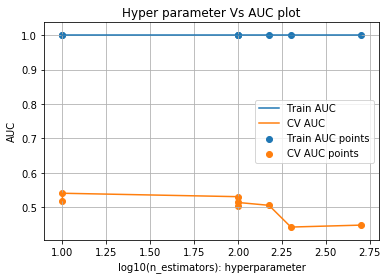

In [272]:
results = results.sort_values(['param_n_estimators'])

train_auc= results['mean_train_score']
train_auc_std= results['std_train_score']
cv_auc = results['mean_test_score'] 
cv_auc_std= results['std_test_score']
C_ =  results['param_n_estimators'].apply(lambda x: math.log10(x))

plt.plot(C_, train_auc, label='Train AUC')

plt.plot(C_, cv_auc, label='CV AUC')

plt.scatter(C_, train_auc, label='Train AUC points')
plt.scatter(C_, cv_auc, label='CV AUC points')


plt.legend()
plt.xlabel("log10(n_estimators): hyperparameter")
plt.ylabel("AUC")
plt.title("Hyper parameter Vs AUC plot")
plt.grid()
plt.show()

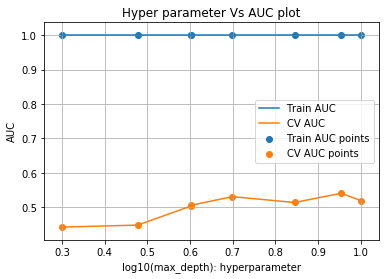

In [273]:
results = results.sort_values(['param_max_depth'])

train_auc= results['mean_train_score']
train_auc_std= results['std_train_score']
cv_auc = results['mean_test_score'] 
cv_auc_std= results['std_test_score']
C_ =  results['param_max_depth'].apply(lambda x: math.log10(x))

plt.plot(C_, train_auc, label='Train AUC')

plt.plot(C_, cv_auc, label='CV AUC')

plt.scatter(C_, train_auc, label='Train AUC points')
plt.scatter(C_, cv_auc, label='CV AUC points')


plt.legend()
plt.xlabel("log10(max_depth): hyperparameter")
plt.ylabel("AUC")
plt.title("Hyper parameter Vs AUC plot")
plt.grid()
plt.show()

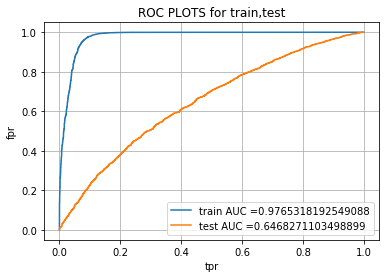

In [274]:
# https://scikit-learn.org/stable/modules/generated/sklearn.metrics.roc_curve.html#sklearn.metrics.roc_curve
GB_ = GradientBoostingClassifier(n_estimators = best_n_estimator, max_depth = best_max_depth)
GB_.fit(X_train_set_4, y_train)
# roc_auc_score(y_true, y_score) the 2nd parameter should be probability estimates of the positive class
# not the predicted outputs

y_train_pred = GB_.predict_proba(X_train_set_4)    
y_test_pred =  GB_.predict_proba(X_test_set_4)   

y_train_pred_prob = []
y_test_pred_prob = []

for index in range(len(y_train_pred)):
    y_train_pred_prob.append(y_train_pred[index][1])

for index in range(len(y_test_pred)):
    y_test_pred_prob.append(y_test_pred[index][1])
    

train_fpr, train_tpr, tr_thresholds = roc_curve(y_train, y_train_pred_prob)
test_fpr, test_tpr, te_thresholds = roc_curve(y_test, y_test_pred_prob)



plt.plot(train_fpr, train_tpr, label="train AUC ="+str(auc(train_fpr, train_tpr)))
plt.plot(test_fpr, test_tpr, label="test AUC ="+str(auc(test_fpr, test_tpr)))

plt.legend()
plt.xlabel("tpr")
plt.ylabel("fpr")
plt.title("ROC PLOTS for train,test")
plt.grid()
plt.show()

the maximum value of tpr*(1-fpr) 0.8847155569088061 for threshold 0.83
Train confusion matrix


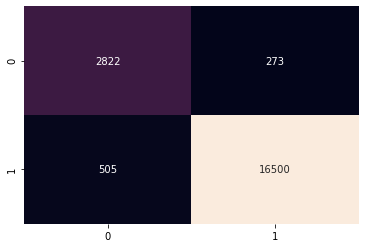

In [275]:
print("="*100)
from sklearn.metrics import confusion_matrix
best_t = find_best_threshold(tr_thresholds, train_fpr, train_tpr)
print("Train confusion matrix")
sns.heatmap(confusion_matrix(y_train, predict_with_best_t(y_train_pred_prob, best_t)),annot = True, fmt = "d", cbar=False)

Test confusion matrix


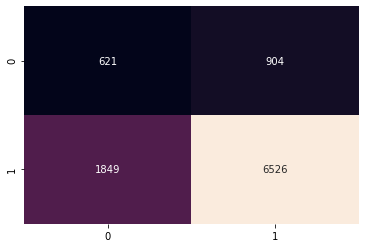

In [276]:
print("Test confusion matrix")
sns.heatmap(confusion_matrix(y_test, predict_with_best_t(y_test_pred_prob, best_t)), annot = True, fmt = "d", cbar=False)

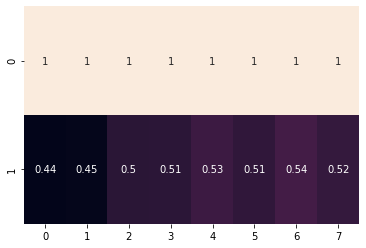

In [277]:
scores = [results['mean_train_score'].values, results['mean_test_score'].values]
sns.heatmap(np.asarray(scores), annot = True, cbar=False)

In [94]:
depth = [2,3,4,5,6,7,8,9,10]
estimators = [10,50,100,150,200,300,500]
plot_3d_plot(X_train_set_4, y_train, X_test_set_4, y_test, depth, estimators, algo = 'GB_')

In [124]:
from prettytable import PrettyTable
    
x = PrettyTable()

x.field_names = ["Model", "Dataset","best_n_estimator", "best_max_depth", "Train AUC", "Test AUC"]

x.add_row(["RandomForestClassfier", "BOW", 200, 9, 0.8760, 0.7002])
x.add_row(["RandomForestClassfier", "TFIDF", 300, 8, 0.8891, 0.6963])
x.add_row(["RandomForestClassfier", "AVG W2V", 500, 4, 0.7576, 0.6950])
x.add_row(["RandomForestClassfier", "TFIDF W2V", 10, 9, 0.9195, 0.6524])
x.add_row(["GradientBoostingClassifier", "BOW", 50, 4, 0.7943, 0.6916])
x.add_row(["GradientBoostingClassifier", "TFIDF", 50, 9, 0.9718, 0.6871])
x.add_row(["GradientBoostingClassifier", "AVG W2v", 150, 3, 0.8482, 0.7031])
x.add_row(["GradientBoostingClassifier", "TFIDF W2V", 10, 10, 0.9765, 0.6468])

print(x)

+----------------------------+-----------+------------------+----------------+-----------+----------+
|           Model            |  Dataset  | best_n_estimator | best_max_depth | Train AUC | Test AUC |
+----------------------------+-----------+------------------+----------------+-----------+----------+
|   RandomForestClassfier    |    BOW    |       200        |       9        |   0.876   |  0.7002  |
|   RandomForestClassfier    |   TFIDF   |       300        |       8        |   0.8891  |  0.6963  |
|   RandomForestClassfier    |  AVG W2V  |       500        |       4        |   0.7576  |  0.695   |
|   RandomForestClassfier    | TFIDF W2V |        10        |       9        |   0.9195  |  0.6524  |
| GradientBoostingClassifier |    BOW    |        50        |       4        |   0.7943  |  0.6916  |
| GradientBoostingClassifier |   TFIDF   |        50        |       9        |   0.9718  |  0.6871  |
| GradientBoostingClassifier |  AVG W2v  |       150        |       3        |   0